# SOGOS Plots

In [1]:
import xarray as xr
import pandas as pd
import numpy as np
import gsw 
import matplotlib.pyplot as plt
from cmocean import cm as cmo
from datetime import datetime
import scipy
# import glidertools as gt
import importlib as lib
import os

# Image
import imageio.v2 as iio
import matplotlib.patches as patch
import cartopy.crs as ccrs                   # import projections
import cartopy.feature as cf                 # import features
from IPython.display import Image

import sgmod_main as sg
import sgmod_L3proc as gproc     # for L3 grid processing
import sgmod_DFproc as dfproc    # for dataframe processing
import sgmod_plotting as sgplot  

# lib.reload(sg)
# lib.reload(sgplot)
# from sgmod_main import gp_659, gp_660, gi_659, gi_660, dav_659, dav_660, df_659, df_660
from sgmod_main import fsle, adt
from sgmod_plotting import lims, palettes

import seaborn as sns

import cartopy.crs as ccrs                   # import projections
import cartopy.feature as cf    


from labellines import labelLines, labelLine

In [2]:
size = 28
params = {'legend.fontsize': 28, 
          'xtick.labelsize':size, 
          'ytick.labelsize':size, 
          'font.size':size,
          'font.family':'Futura'}
plt.rcParams.update(params)

In [4]:
file_path = '/Users/sangminsong/OneDrive - UW/Code/SOGOS/gridded-vars/'
gi_659o = xr.open_dataset(file_path + 'gi_659_forMLGeo1026.nc')
gi_660o = xr.open_dataset(file_path + 'gi_660_forMLGeo1026.nc')

gp_659o = xr.open_dataset(file_path + 'gp_659_forMLGeo1026.nc')
gp_660o = xr.open_dataset(file_path + 'gp_659_forMLGeo1026.nc')

In [13]:

# Open grids
gp_659 = xr.open_dataset(file_path + 'gp_659_0910.nc')
gp_660 = xr.open_dataset(file_path + 'gp_660_0910.nc')

gi_659 = xr.open_dataset(file_path + 'gi_659_0910.nc')
gi_660 = xr.open_dataset(file_path + 'gi_660_0910.nc')

In [14]:
gp_659['oxycor'] = gp_659o.oxygen
gp_660['oxycor'] = gp_660o.oxygen

gi_659['oxycor'] = gi_659o.oxygen
gi_660['oxycor'] = gi_660o.oxygen

In [93]:
file_path = '../working-vars/glider/'
df_659 = pd.read_csv(file_path + 'df_659_tsO2corr_0920.csv', index_col=0)
df_660 = pd.read_csv(file_path + 'df_660_tsO2corr_0920.csv', index_col=0)

file_path = '../working-vars/glider/'
dav_659 = xr.open_dataset(file_path + 'dav_659_0910.nc')
dav_660 = xr.open_dataset(file_path + 'dav_660_0910.nc')

In [94]:
file_path = '../working-vars/RF-training/'
shipDF = pd.read_csv(file_path + 'mldata_shipDF_RF_ver19.csv', index_col=0)
floatDF = pd.read_csv(file_path + 'mldata_floatDF_RF_ver19.csv', index_col=0)

sogos = floatDF[floatDF.wmoid==5906030]

In [4]:
aviso = xr.open_dataset('/Users/sangminsong/Library/CloudStorage/OneDrive-UW/Code/SOGOS/data/dataset-duacs-nrt-global-merged-allsat-phy-l4_1637011653931.nc')
# Calculate EKE
aviso['eke'] = np.sqrt(aviso.ugosa**2 + aviso.vgosa**2)

In [11]:
# Float Data
# file_path = '/Users/sangminsong/Library/CloudStorage/OneDrive-UW/Code/SOGOS-ML/working-vars/go-bgc/'
# float_data = pd.read_csv(file_path + 'argo_qc_fulldepth_0531.csv', index_col=[0])
# float_data = float_data.reset_index(drop = True)

# wmo_list = pd.unique(float_data.wmoid)
# excluded_floats = [5906032, 5906035, 5906036]
# wmoids = [x for x in wmo_list if x not in excluded_floats]
# # print(wmoids)

# floatDF = float_data[~float_data['wmoid'].isin(excluded_floats)] # 9 floats

# sogos = floatDF[floatDF.wmoid==5906030]

In [14]:
wmoids = pd.unique(floatDF.wmoid)

# Set up WMO color palette
pal = sns.color_palette("Paired")
wmo_colors = dict.fromkeys(wmoids)
for i, wmo in enumerate(wmoids):
    wmo_colors[wmo] = pal[i]

/opt/homebrew/Caskroom/mambaforge/base/envs/mlsogos/lib/python3.8/site-packages/labellines/core.py:204: UserWarning: The value at position 1 in `xvals` is outside the range of its associated line (xmin=56.593, xmax=64.538, xval=47.74086571428571). Clipping it into the allowed range.
  warnings.warn(
/opt/homebrew/Caskroom/mambaforge/base/envs/mlsogos/lib/python3.8/site-packages/labellines/core.py:204: UserWarning: The value at position 5 in `xvals` is outside the range of its associated line (xmin=56.495, xmax=64.896, xval=56.16944285714285). Clipping it into the allowed range.
  warnings.warn(


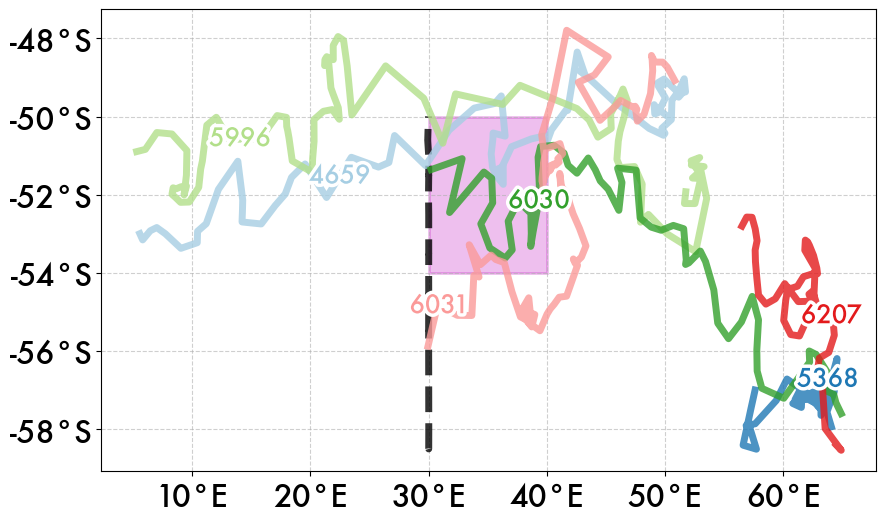

In [95]:
# Reference: Full matchup map for floats, so we can see where the holdout floats are
fig = plt.figure(figsize=(10,6))

ax=plt.gca()

for wmo in wmoids:
    ax.plot(floatDF[floatDF.wmoid==wmo].lon,floatDF[floatDF.wmoid==wmo].lat,
            color = wmo_colors[wmo], alpha=0.8, linewidth=5, label=str(wmo)[3:], zorder=3)
    
# plt.title('SOGOS BGC-Argo Matchups (2018-2020)')
rect = patch.Rectangle((30,-54),10,4, fill=True, color="m", alpha=0.25,linewidth=2, zorder=1)

# ax.legend()
ax.add_patch(rect)
# ax.set_xlim(5,61)
# ax.set_ylim(-60,-30)

# ax.set_xlabel('longitude')
# ax.set_ylabel('latitude')
# ax.set_aspect('equal')

ax.yaxis.set_major_formatter("{x:1.0f}°S")
ax.xaxis.set_major_formatter("{x:1.0f}°E")

ax.grid(linestyle='dashed', alpha=0.6, zorder=1)

lines = ax.get_lines()
labelLines(lines, align=False, fontsize=18, zorder=3)

# labelLines(lins) # , align=False, fontsize=18)


plt.plot(shipDF.lon, shipDF.lat, alpha=0.8, linestyle='dashed', c='k', linewidth=5)


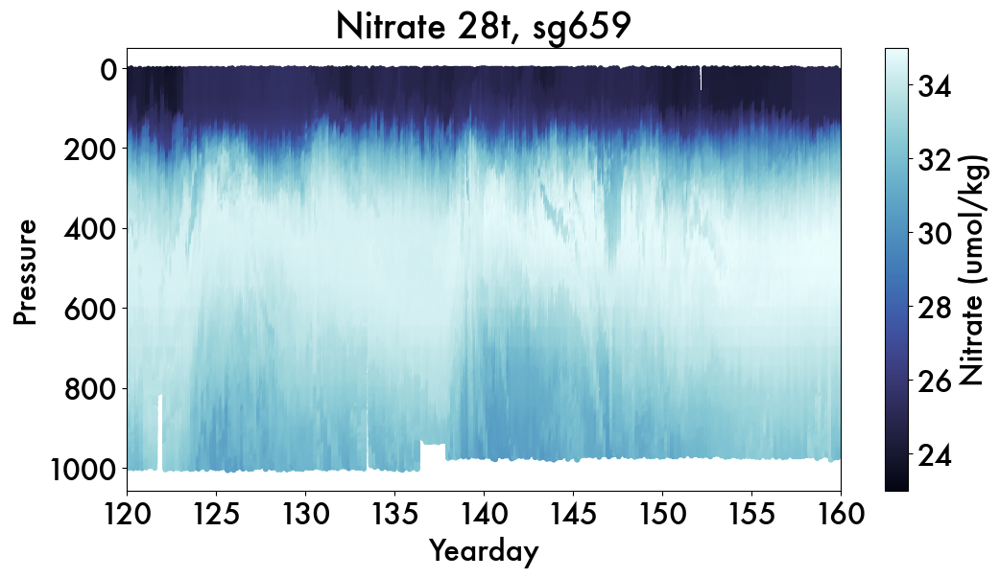

In [21]:
fig = plt.figure(figsize=(12,6))
ax = fig.gca()
sca = plt.scatter(df_659.yearday, df_659.pressure, c=df_659.nitrate_28t, cmap=cmo.ice, s=10, vmin=23, vmax=35)

plt.colorbar(sca, ax=ax).set_label('Nitrate (umol/kg)')
# plt.style.use("dark_background")

ax.invert_yaxis()
ax.set_ylabel('Pressure')
ax.set_xlabel('Yearday')
ax.set_xlim([120, 160])
plt.title('Nitrate 28t, sg659')
plt.show()



In [22]:
# time between glider profiles 

import sgmod_DFproc as dfproc
import sgmod_main as sg

glider_time_res = []
glider_prof_times = []


for l in dfproc.list_profile_DFs(df_659):
    glider_prof_times.append(l.yearday.mean())

avg_diff = np.diff(glider_prof_times).mean()
print(avg_diff)

0.09488546991946345
0.09488546991946345
None


In [31]:
# glider sampling frequency 
glider_obs_res = []
for l in dfproc.list_profile_DFs(df_659):
    l=l.sort_values(by='pressure')
    temp = np.array(np.diff(l.yearday))
    glider_obs_res.append(np.abs(temp.mean()))

avg_diff = np.array(glider_obs_res).mean()  # in days 
print(avg_diff*24*60*60)  # in seconds

10.005984127544746


# Float Maps

In [ ]:
# Reference: Full matchup map for floats
fig = plt.figure(figsize=(14,8))
ax=plt.gca()

for wmo in wmoids[wmoids!=5906030]:
    ax.plot(floatDF[floatDF.wmoid==wmo].lon,floatDF[floatDF.wmoid==wmo].lat,
            color = wmo_colors[wmo], alpha=0.2, linewidth=5, label=str(wmo)[3:], zorder=3)
    ax.scatter(floatDF[floatDF.wmoid==wmo].lon,floatDF[floatDF.wmoid==wmo].lat,
            color = wmo_colors[wmo], alpha=0.1, s=20, zorder=3)

for wmo in [5906030]:
    ax.plot(floatDF[floatDF.wmoid==wmo].lon,floatDF[floatDF.wmoid==wmo].lat,
            color = wmo_colors[wmo], alpha=0.4, linewidth=7, label=str(wmo)[3:], zorder=3)
    ax.scatter(floatDF[floatDF.wmoid==wmo].lon,floatDF[floatDF.wmoid==wmo].lat,
            color = wmo_colors[wmo], alpha=0.1, s=30, zorder=3)

# plt.title('SOGOS BGC-Argo Matchups')
plt.title('Argo Yeardays: ' + str(start_yd) + ' to ' + str(end_yd))
rect = patch.Rectangle((30,-54),10,4, fill=True, color="orange", alpha=0.25,linewidth=2, zorder=1)


# ax.legend()
ax.add_patch(rect)
# ax.set_xlim(5,81)
# ax.set_ylim(-60,-30)
ax.set_aspect('equal')

ax.yaxis.set_major_formatter("{x:1.0f}°S")
ax.xaxis.set_major_formatter("{x:1.0f}°E")

ax.grid(linestyle='dashed', alpha=0.6, zorder=1)

lines = ax.get_lines()
labelLines(lines, align=False, fontsize=18, zorder=3)
# labelLines(lins) # , align=False, fontsize=18)
plt.plot(shipDF.lon, shipDF.lat, alpha=0.8, linestyle='dashed', c='k', linewidth=5)

# Glider Maps

In [21]:
np.arange(120,200,10)

array([120, 130, 140, 150, 160, 170, 180, 190])

In [ ]:
    i = np.where(dav_659.days.round()==day)
    plt.scatter(dav_659.lon[i], dav_659.lat[i], 140, color='w', label = '659')

Text(0.5, 1.0, 'Glider 660')

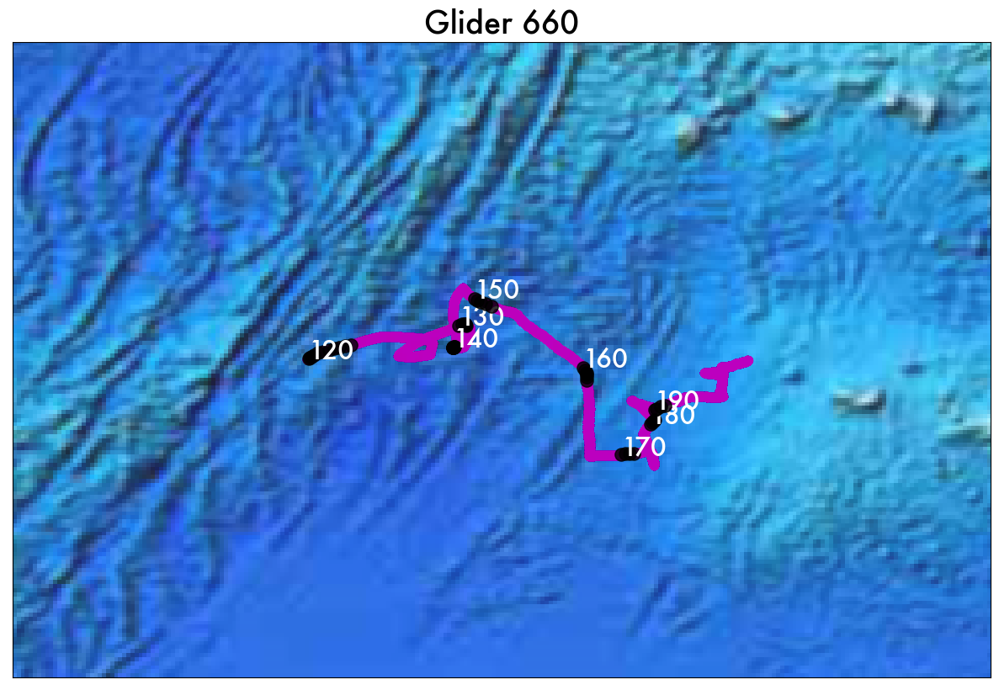

In [75]:
fig = plt.figure(figsize=(15, 10), edgecolor='w')
m = Basemap(projection='cyl', resolution='h',
            llcrnrlat=-58, urcrnrlat=-45,
            llcrnrlon=24, urcrnrlon=44)


m.etopo(scale=0.8, alpha=0.9)

df=df_660
tag= '660'

lon = df.lon.values
lat = df.lat.values
xpt, ypt=m(lon,lat)

# m.plot(xpt, ypt, color = 'k', alpha=0.1, linewidth=2, label=tag, zorder=3)
m.scatter(xpt, ypt , color = 'm', alpha=0.3, s=50, zorder=3)

gliderdat = dav_660.where(dav_660.days<200)

for day in np.arange(120,200,10):
    # plt.plot(gliderdat.lon, gliderdat.lat, linewidth=8, color='orange', alpha=0.9, zorder=1)
    i = np.where(gliderdat.days.round()==day)
    lon = gliderdat.lon[i]
    lat = gliderdat.lat[i]
    xpt, ypt=m(lon,lat)
    m.scatter(xpt, ypt , s=120, color = 'k', alpha=0.8, zorder=3)
    plt.annotate(str(day), (xpt[0], ypt[0]), color='w')
plt.title('Glider 660')

In [24]:
dav_659.days

<xarray.DataArray 'days' (dive: 463)>
array([       nan,        nan, 119.588869, ..., 205.540516, 205.755331,
       205.974141])
Coordinates:
  * dive     (dive) int64 0 1 2 3 4 5 6 7 8 ... 455 456 457 458 459 460 461 462

In [30]:
dav_659.where(dav_659.days<200)

<xarray.Dataset>
Dimensions:    (dive: 463)
Coordinates:
  * dive       (dive) int64 0 1 2 3 4 5 6 7 ... 455 456 457 458 459 460 461 462
Data variables:
    u_dive     (dive) float32 nan nan 0.612 0.613 0.568 ... nan nan nan nan nan
    v_dive     (dive) float32 nan nan 0.577 0.465 0.283 ... nan nan nan nan nan
    u_surface  (dive) float32 nan nan 75.29 78.6 79.47 ... nan nan nan nan nan
    v_surface  (dive) float32 nan nan 65.34 60.27 41.25 ... nan nan nan nan nan
    lat        (dive) float32 nan nan -51.44 -51.42 -51.39 ... nan nan nan nan
    lon        (dive) float32 nan nan 30.15 30.22 30.33 ... nan nan nan nan nan
    days       (dive) float64 nan nan 119.6 119.6 119.7 ... nan nan nan nan nan
    mld        (dive) float64 nan nan 50.0 105.0 169.0 ... nan nan nan nan nan
    bfsle      (dive) float64 nan nan -0.1641 -0.2189 ... nan nan nan nan
Attributes: (12/49)
    id:                              sg659_level3
    time_coverage_resolution:        PT1S
    geospatial_vertical_units:       meter
    geospatial_vertical_resolution:  meter
    geospatial_vertical_positive:    no
    platform:                        glider
    ...                              ...
    time_coverage_duration:          P0000-00-208T13:54:40
    geospatial_vertical_min:         0.00
    geospatial_vertical_max:         1000.00
    date_created:                    2021-09-24T17:29:48Z
    date_modified:                   2021-09-24T17:29:48Z
    uuid:                            0440e19e-1d5d-11ec-9be7-acde48001122

Text(0.5, 1.0, 'Glider 660')

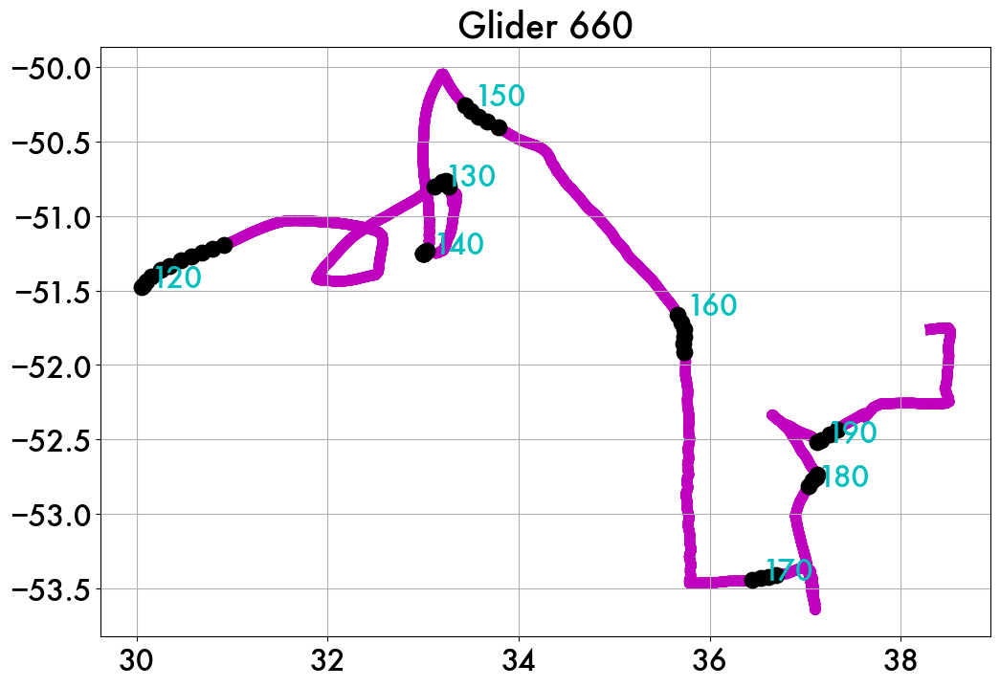

In [76]:
# Plot labeled
fig = plt.figure(figsize=(12,8))
ax = fig.gca()
# ax.set_aspect('equal')
ax.grid(zorder=1)


for day in np.arange(150,200,10):
    plt.scatter(dav_660.lon.values, dav_660.lat.values, linewidth=8, color='m', alpha=0.9, zorder=1)
    i = np.where(dav_660.yearday.round()==day)
    ax.text(dav_660.lon.loc[i].values[0]+.1, dav_660.lat.loc[i].values[0], str(day), color='c')


plt.title('Glider 660')

In [ ]:
dav = dav_659
llcoords = [31,35.5,-52.5, -49]
# file_path = '/Users/sangminsong/OneDrive - UW/Code/SOGOS/scripts/working-figs/'
# fname = 'ADTstudyregion_2glider_path_yd'
savefig = False
# savefig = True

daylist = np.arange(145,146,1)
for day in daylist:
    fig = plt.figure(figsize=(10,7))


    dat = fsle.sel(time=sg.ytd2datetime(day))

    ax = plt.axes(projection=ccrs.PlateCarree())
    gl = ax.gridlines(draw_labels=True,alpha=0.33, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    ax.set_extent(llcoords)

    map = dat.fsle_max.plot(cmap=cmo.ice_r, ax=ax, transform=ccrs.PlateCarree(), add_colorbar=False)
    plt.plot(dav_659.lon, dav_659.lat, linewidth=8, color='orange', alpha=0.9)
    i = np.where(dav_659.days.round()==day)
    plt.scatter(dav_659.lon[i], dav_659.lat[i], 140, color='w', label = '659')

    plt.title('surface strain')
    plt.ylabel('')
    plt.xlabel('')

    # cax = fig.add_axes([ax.get_position().x1+0.04,ax.get_position().y0+.04,0.03,ax.get_position().height*.9])
    # cbar = plt.colorbar(map, cax)
    # cbar.ax.tick_params(labelsize=28) 

plt.show()
plt.close()
# Image(file_path + fname + str(120) + '.png') 

# Glider Profiles

In [79]:
df_660

,juld,yearday,lat,lon,pressure,CT,SA,oxygen,buoyancy,bbp_700,depth,profid,dive,sigma0,spice,AOU,o2sat,log_buoyancy
4032,2019-04-30 12:14:50.707000064,119.510309,-51.4954,30.0251,4.035,3.653773,33.96022,326.859426,-1.051859e-06,0.000283,4,6600000,1,27.013210,-0.409161,-6.502479,320.356948,NaN
5040,2019-04-30 12:14:55.707000064,119.510367,-51.4953,30.0251,5.044,3.649773,33.96122,327.084300,-1.051859e-06,0.000207,5,6600000,1,27.014391,-0.408886,-6.698717,320.385583,NaN
6048,2019-04-30 12:15:00.707000064,119.510425,-51.4953,30.0252,6.053,3.650773,33.96022,327.267310,-1.181382e-05,0.000193,6,6600000,1,27.013503,-0.409485,-6.887058,320.380252,NaN
7056,2019-04-30 12:15:08.206500096,119.510512,-51.4953,30.0252,7.062,3.648773,33.95822,327.392493,-8.461052e-06,0.000283,7,6600000,1,27.012116,-0.411114,-6.991729,320.400764,NaN
8064,2019-04-30 12:15:15.707000064,119.510598,-51.4952,30.0253,8.070,3.646773,33.95822,327.518402,2.355395e-05,0.000227,8,6600000,1,27.012310,-0.411330,-7.102091,320.416311,-10.656217
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
966671,2019-07-25 20:57:50.200000000,205.873498,-51.5287,39.0112,968.672,2.114773,34.87422,182.209926,3.746761e-06,NaN,958,6601013,509,27.876441,0.081985,148.184300,330.394226,-12.494619
967679,2019-07-25 20:57:40.200499968,205.873382,-51.5287,39.0112,969.685,2.114773,34.87522,182.221260,3.746761e-06,NaN,959,6601013,509,27.877237,0.082687,148.170391,330.391651,-12.494619
968687,2019-07-25 20:57:30.200000000,205.873266,-51.5287,39.0112,970.699,2.114773,34.87522,182.230071,0.000000e+00,NaN,960,6601013,509,27.877237,0.082687,148.161583,330.391654,-inf
969695,2019-07-25 20:57:22.700999936,205.873179,-51.5288,39.0111,971.712,2.114773,34.87522,182.271982,3.737237e-06,NaN,961,6601013,509,27.877237,0.082687,148.119676,330.391657,-12.497164


In [82]:
df_660.bbp_700.describe()

count    405294.000000
mean          0.000137
std           0.000041
min          -0.000038
25%           0.000117
50%           0.000130
75%           0.000148
max           0.004207
Name: bbp_700, dtype: float64

(500.0, 0.0)

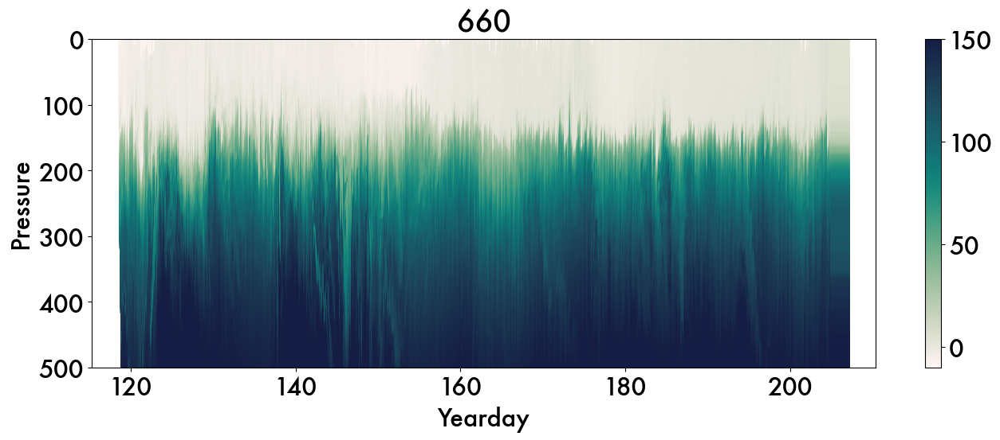

In [90]:
# SINGLE TEST RELATIVE ERROR PROFILE
dat = df_659
fig  = plt.figure(figsize=(14,6), tight_layout=True)
ax = plt.gca()

sca = ax.scatter(dat.yearday, dat.pressure, c=dat.AOU, cmap=cmo.tempo, s=250, marker='s', vmin=-10, vmax=150) #, vmin=.00005, vmax=.002)
ax.set_title(tag)
# plt.colorbar()

# ticklist = [-0.5, -0.025, 0, 0.025, 0.5] 
cbar = plt.colorbar(sca, ax=ax) #, ticks=ticklist) 
# cbar.set_label('Relative Error (%)')
# cbar.ax.set_yticklabels(['-5.0%', '-2.5%', '0%', '2.5%', '5.0%'])  # Setting tick labels here



ax.invert_yaxis()
ax.set_ylabel('Pressure')
ax.set_xlabel('Yearday')
# ax.set_xlim([120, 550])
ax.set_ylim([500,0])


When AOU is 0, that means the O2sol is equal to the oxygen in situ (recently ventilated)

When biology production is high, then situ oxygen can be higher than o2sol expected, and we get a negtaitve* AOU

When biological respiration (utilization of oxygen) then the in situ oxygen can be much lower than o2 sol, and we get a high AOU. 

# Gridded time-depth plots from L3 processing - 
Profiles over time'

Options for vars[]:
['SA', 'CT', 'oxygen', 'AOU', 'pH', 'TA']

In [267]:
lib.reload(sgplot)

<module 'sgmod_plotting' from '/Users/sangminsong/Library/CloudStorage/OneDrive-UW/Code/SOGOS/scripts/sgmod_plotting.py'>

In [ ]:
def plot_var(g3, var='SA'):
    """"
    Quick plot for single variable, for troubleshooting code.
    @param      gp_glider: gridded dataset
                var: Options are 'SA', 'CT', 'oxygen', 'AOU', 'spice'"""
    
    fig = plt.figure(figsize=(8,4))
    ax = fig.gca()
    # g3_glider[var].plot(ax=ax, vmax=325, cmap=cmo.ice)
    # ax.margins(x=0.01)
    # ax.invert_yaxis()
    # ax.set_xlabel('profile number')

    g3.plot.scatter('days', 'sigma', hue='oxygen', vmax=325, cmap=cmo.ice, s=2, zorder=3)

    ax.margins(x=0.01)
    ax.invert_yaxis()
    ax.set_xlabel('days')
    ax.set_ylabel('$\sigma$')
    ax.set_title('oxygen - time lag corrected')
    plt.grid(visible=True, axis='x', zorder=0)

plot_var(gproc.trim(gp_659,130, 160), var='oxygen')

In [ ]:
plot_var(gproc.trim(gp_659,135, 160), var='oxygen')

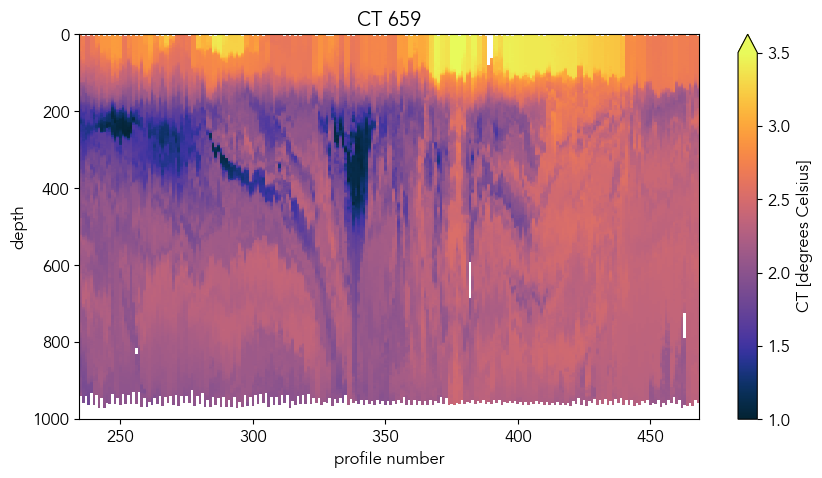

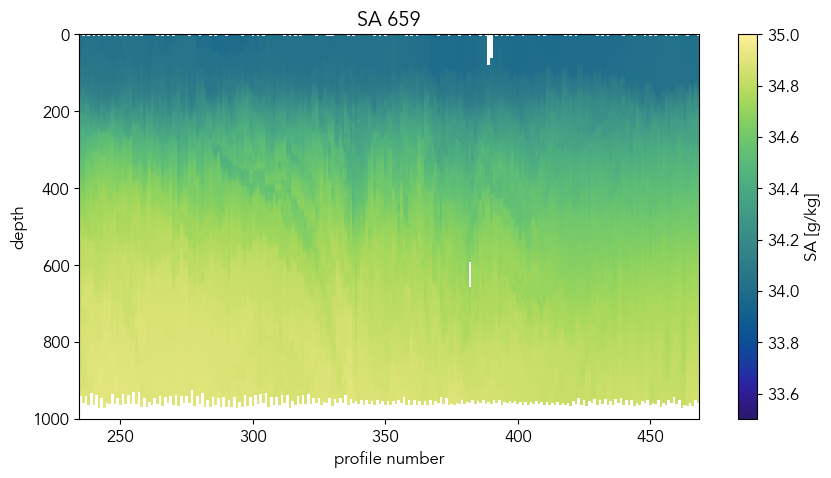

In [268]:
# Quick plot using sgplot module 
g = gproc.trim(gp_659, 140, 160)
sgplot.gridx_nprof(g, vars=['CT', 'SA'], tag='659')
sgplot.gridx_nprof(gp_660, vars=['oxygen'], tag='660')
# sgplot.gridx_nprof(gp_659, vars=['TA'], tag='659')
# ['salinity', 'temperature', 'oxygen', 'AOU', 'pH', 'TA']


AttributeError: 'Dataset' object has no attribute 'pH'

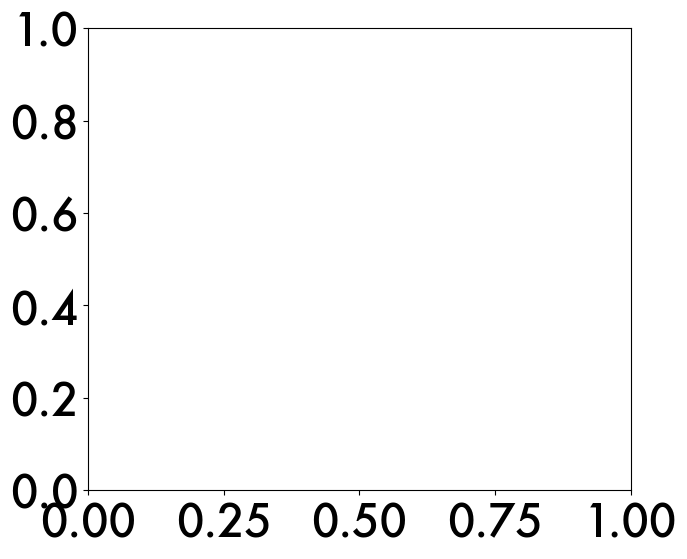

In [9]:
grid = gp_659
fig= plt.figure(figsize=(7,6))
ax = fig.gca()

im = ax.scatter(grid.SA, grid.CT, c=grid.pH, cmap='cmo.matter', s=0.5)
ax.set_ylabel('temperature')
ax.set_xlabel('salinity')
ax.set_title('glider 659 - pH')
plt.colorbar(im)

## Single Profiles

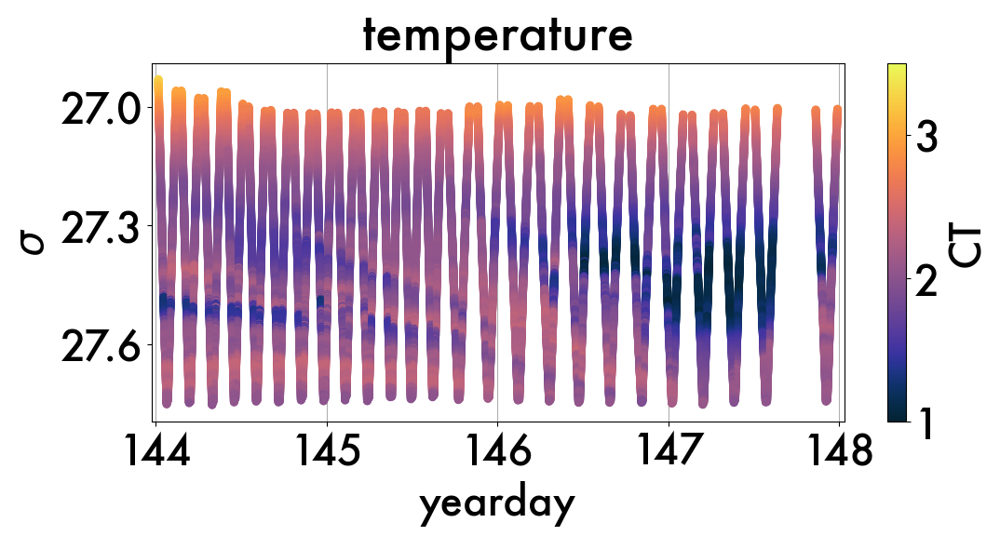

In [17]:
# single plot temp prof
d1=144
d2=148

g3 = gproc.trim(gi_659, d1, d2)
v= 'CT'

fig = plt.figure(figsize=(12,5))
ax=fig.gca()

min =  lims[v][0]
max =  lims[v][1]
c = palettes[v]
        
g3.plot.scatter('days', 'sigma', hue=v, vmin=min, vmax=max, cmap=cmo.thermal, ax=ax, s=30, zorder=3)
# g3[v].plot(vmin=min, vmax=max, cmap=c)
ax.margins(x=0.01)
ax.invert_yaxis()
ax.set_xlabel('yearday')
ax.set_ylabel('$\sigma$')
ax.set_title('temperature')
plt.grid(visible=True, axis='x', zorder=0)


ax.set_xticks(np.arange(d1, d2+0.1, 1))
ax.set_yticks(np.arange(27.0, 27.9, .3))



In [55]:
gi_659

<xarray.Dataset>
Dimensions:   (nprof: 912, sigma: 1001)
Coordinates:
  * sigma     (sigma) float64 26.8 26.8 26.8 26.8 26.8 ... 27.8 27.8 27.8 27.8
  * nprof     (nprof) int64 0 1 2 3 4 5 6 7 ... 904 905 906 907 908 909 910 911
Data variables:
    time      (sigma, nprof) datetime64[ns] ...
    days      (sigma, nprof) float64 119.6 119.6 119.6 119.6 ... nan nan nan nan
    lat       (sigma, nprof) float32 ...
    lon       (sigma, nprof) float32 ...
    dive      (nprof) int16 2 2 3 3 4 4 5 5 ... 459 459 460 460 461 461 462 462
    SA        (sigma, nprof) float64 ...
    CT        (sigma, nprof) float64 ...
    oxygen    (sigma, nprof) float64 ...
    P         (sigma, nprof) float64 ...
    buoyancy  (sigma, nprof) float64 ...
    AOU       (sigma, nprof) float64 ...
    pH        (sigma, nprof) float64 ...
    oxycor    (sigma, nprof) float64 ...

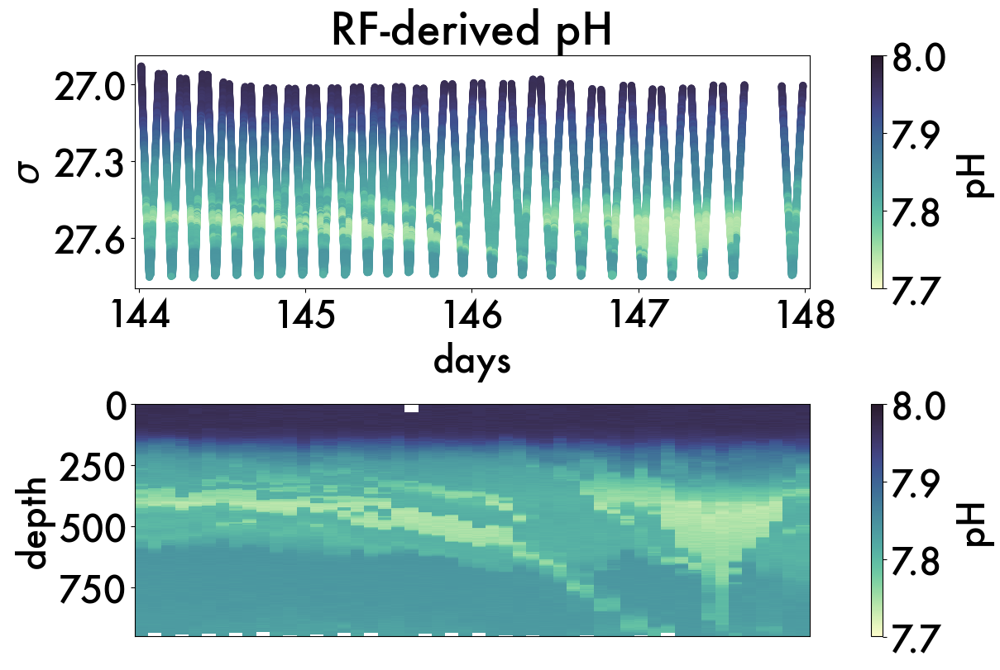

In [73]:
# 2 subplot version with sigma and pressure versions. 
d1=144
d2=d1+4


g3 = gproc.trim(gi_659, d1,d2)
gp = gproc.trim(gp_659, d1,d2)
v= 'pH'

fig, axs = plt.subplots(2,1, figsize=(12,8), constrained_layout=True)
ax = axs.flatten()


# for oxygen
# g3.plot.scatter('days', 'sigma', hue=v, cmap=cmo.amp, ax=ax[0], s=30, zorder=3)
# gp[v].plot(cmap=cmo.amp, ax=ax[1])

# for pH
g3.plot.scatter('days', 'sigma', hue=v, cmap=cmo.deep, vmin=7.7, vmax=8, ax=ax[0], s=30, zorder=3)
gp[v].plot(vmin=7.7, vmax=8, cmap=cmo.deep, ax=ax[1])

for axis in ax:
    axis.margins(x=0.01)
    axis.invert_yaxis()


ax[0].set_title('RF-derived pH')
ax[0].set_xticks(np.arange(d1, d2+0.1, 1))
ax[0].set_ylabel('$\sigma$')
ax[0].set_yticks(np.arange(27.0, 27.9, .3))
# ax[0].set_xlim(144.5,146.6)

ax[1].set_xlabel('')
ax[1].set_xticks([])
ax[1].set_ylabel('depth')
ax[1].set_yticks(np.arange(0, 900.1, 250))
ax[1].set_ylim([950,0])


plt.grid(visible=True, axis='x', zorder=0)


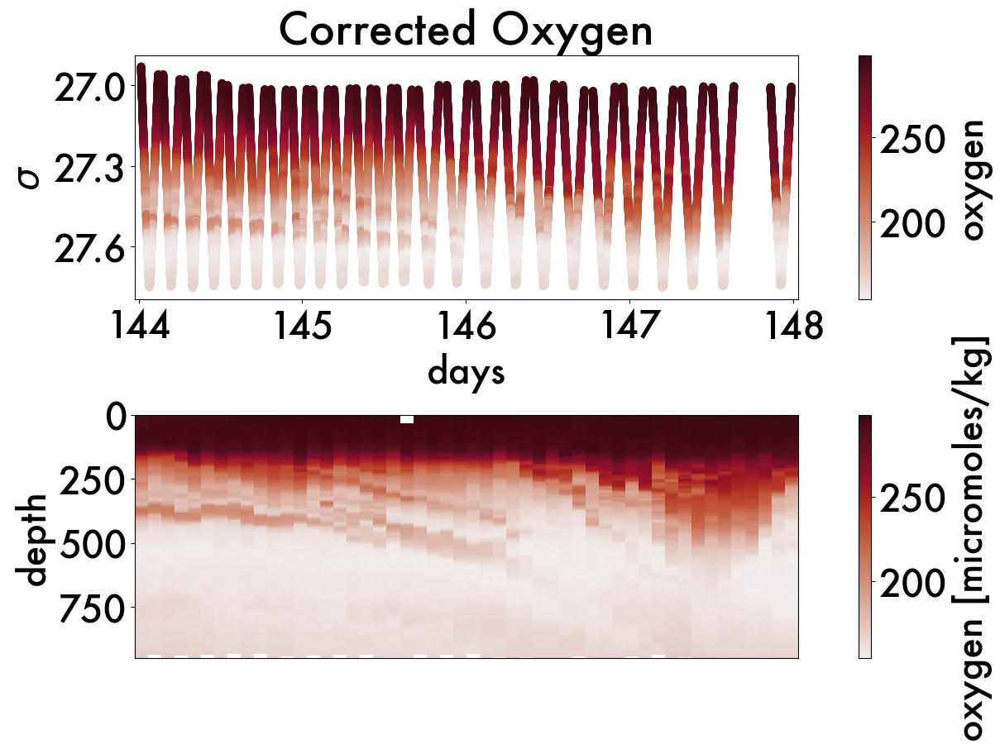

In [72]:
d1=144
d2=d1+4

g3 = gproc.trim(gi_659, d1,d2)
gp = gproc.trim(gp_659, d1,d2)
v= 'oxygen'

fig, axs = plt.subplots(2,1, figsize=(12,8), constrained_layout=True)
ax = axs.flatten()

min =  lims[v][0]
max =  lims[v][1]
c = palettes[v]
        
g3.plot.scatter('days', 'sigma', hue=v, cmap=cmo.amp, ax=ax[0], s=39, zorder=3)
gp[v].plot(cmap=cmo.amp, ax=ax[1])

# ph - deep
for axis in ax:
    axis.margins(x=0.01)
    axis.invert_yaxis()


ax[0].set_title('Corrected Oxygen')
ax[0].set_xticks(np.arange(d1, d2+0.1, 1))
ax[0].set_ylabel('$\sigma$')
ax[0].set_yticks(np.arange(27.0, 27.9, .3))
# ax[0].set_xlim(144.5,146.6)

ax[1].set_xlabel('')
ax[1].set_xticks([])
ax[1].set_ylabel('depth')
ax[1].set_yticks(np.arange(0, 900.1, 250))
ax[1].set_ylim([950,0])


plt.grid(visible=True, axis='x', zorder=0)


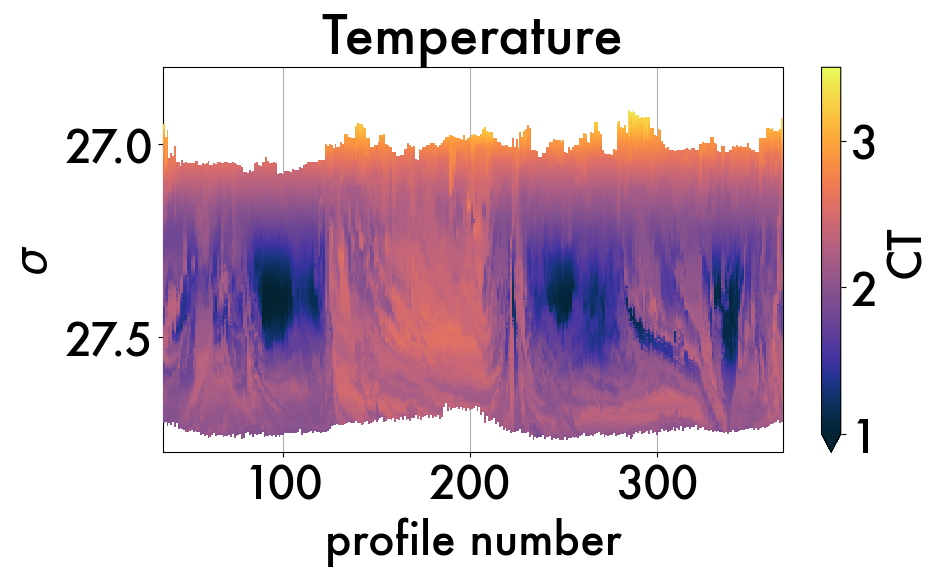

In [18]:
g3 = gproc.trim(gi_659, 123, 150)
v= 'CT'

fig = plt.figure(figsize=(10,5))
ax = fig.gca()

min =  lims[v][0]
max =  lims[v][1]
c = palettes[v]
g3[v].plot(vmin=min, vmax=max, cmap=c, ax=ax, zorder=3)

ax.margins(x=0.01)
ax.invert_yaxis()
ax.set_title('Temperature')
ax.set_xlabel('profile number')
ax.set_ylabel('$\sigma$')
plt.grid(visible=True, axis='x', zorder=0)


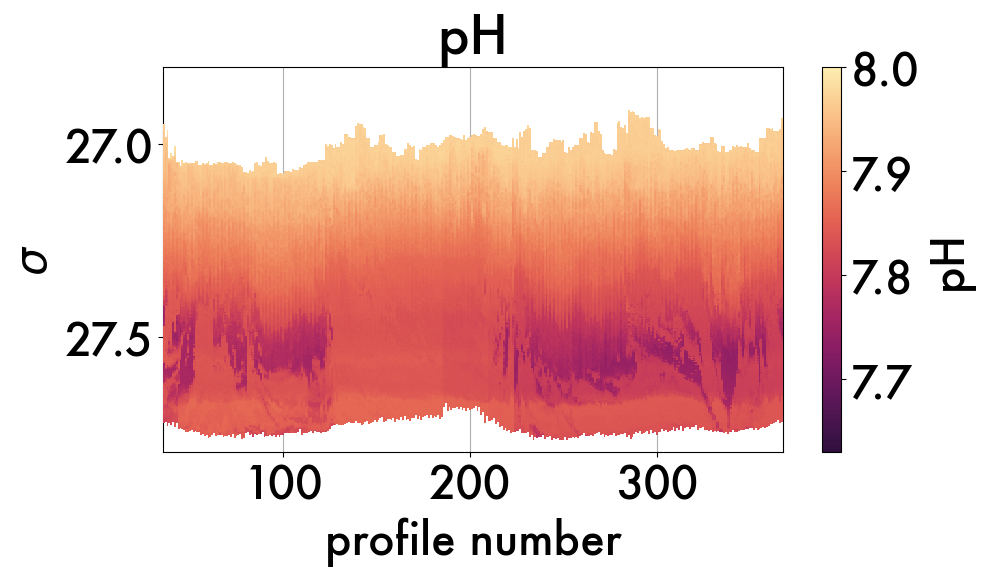

In [19]:
g3 = gproc.trim(gi_659, 123, 150)
v= 'pH'

fig = plt.figure(figsize=(10,5))
ax = fig.gca()

min =  lims[v][0]
max =  lims[v][1]
c = palettes[v]
g3[v].plot(vmin=min, vmax=max, cmap=c, ax=ax, zorder=3)

ax.margins(x=0.01)
ax.invert_yaxis()
ax.set_title('pH')
ax.set_xlabel('profile number')
ax.set_ylabel('$\sigma$')
plt.grid(visible=True, axis='x', zorder=0)

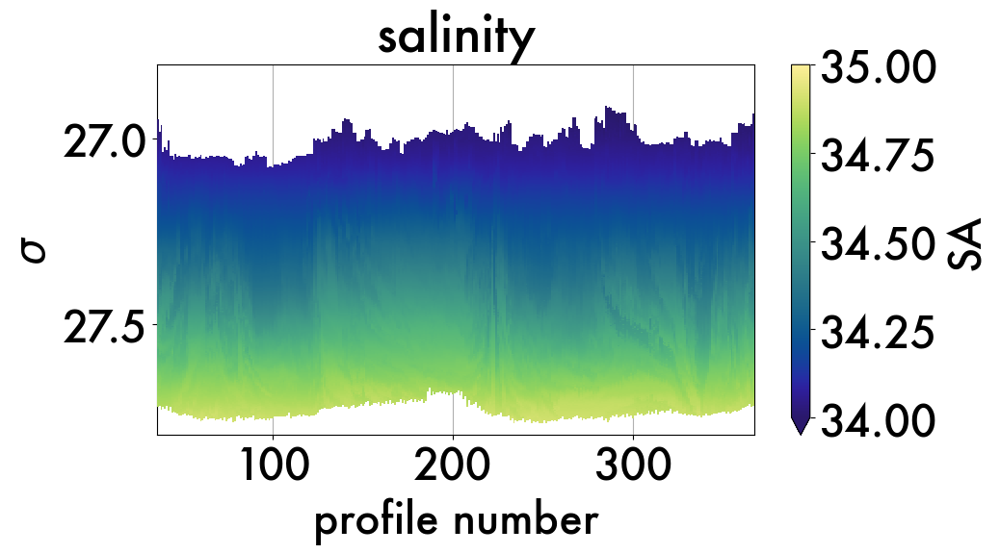

In [21]:
g3 = gproc.trim(gi_659, 123, 150)
v= 'SA'

fig = plt.figure(figsize=(10,5))
ax = fig.gca()

min =  34.0
max =  35
c = palettes[v]
g3[v].plot(vmin=min, vmax=max, cmap=cmo.haline, ax=ax, zorder=3)

ax.margins(x=0.01)
ax.invert_yaxis()
ax.set_title('salinity')
ax.set_xlabel('profile number')
ax.set_ylabel('$\sigma$')
plt.grid(visible=True, axis='x', zorder=0)

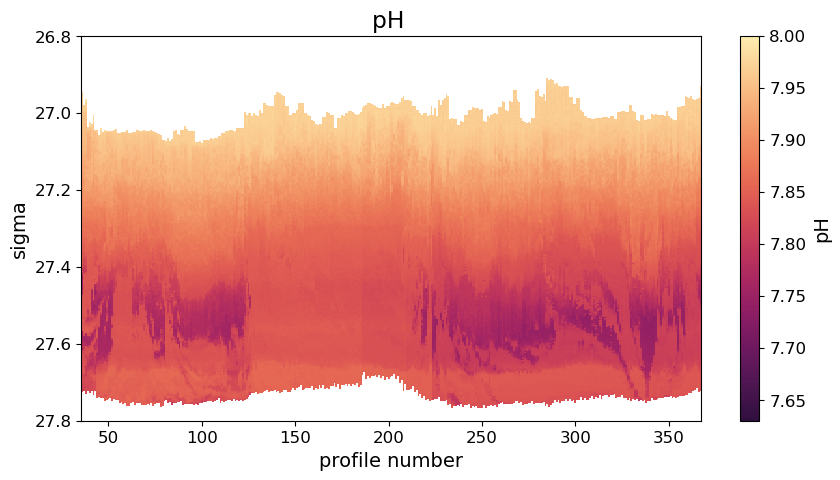

In [ ]:
g3 = gproc.trim(gi_659, 123,150)
# fig = sgplot.gridx_nprof(g3, vars=['oxygen'], lim=[150,350])
fig = sgplot.gridx_nprof(g3, vars=['pH'])

In [ ]:
sgplot.gridx_nprof(gp_660, vars=['oxygen', 'AOU'], tag='660')
sgplot.gridx_nprof(gi_660, vars=['oxygen', 'AOU'], tag='660')

sgplot.gridx_days(gp_660, ycoord='depth', vars=['oxygen'], tag='660')
sgplot.gridx_days(gi_660, ycoord='sigma', vars=['AOU'], tag='660')

# Oxygen Dive Striations

(27.35, 27.15)

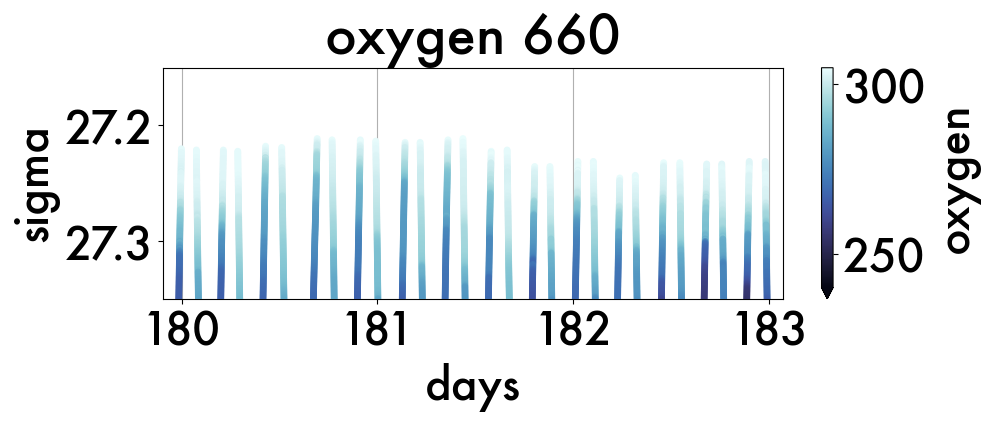

In [22]:
g3 = gproc.trim(gi_660, 180,183)

fig = plt.figure(figsize=(10,3))
ax = fig.gca()

v='oxygen'
g3.plot.scatter('days','sigma', hue=v, cmap=palettes[v], s=15, zorder=3, vmin=240, ax=ax)
ax.invert_yaxis()
ax.margins(x=0.01)

plt.grid(visible=True, axis='x', zorder=0)
ax.set_title('oxygen 660')
ax.set_ylim([27.35,27.15])

In [23]:
d1 = 178
d2 = 181

g3 = gproc.trim(gi_660, d1,d2)
gi_660.oxygen.attrs['long_name'] = 'oxygen (umol/kg)'
gi_660.oxygen.attrs['units'] = ''
gi_660.oxygen_raw.attrs['long_name'] = 'oxygen (umol/kg)'


fig = plt.figure(figsize=(10,3))
ax = fig.gca()

v='oxygen'
g3['oxygen'].plot(cmap=palettes[v], vmin=lims[v][0], vmax=lims[v][1], ax=ax)
ax.invert_yaxis()
ax.margins(x=0.01)

plt.grid(visible=True, axis='x', zorder=0)
ax.set_title('oxygen 660')
ax.set_ylim([27.5,27.15])


# compare to oxygen_raw
g3 = gproc.trim(gi_660, d1,d2)

fig = plt.figure(figsize=(10,3))
ax = fig.gca()

v='oxygen'
g3['oxygen_raw'].plot(cmap=palettes[v], vmin=lims[v][0], vmax=lims[v][1], ax=ax)
ax.invert_yaxis()
ax.margins(x=0.01)

plt.grid(visible=True, axis='x', zorder=0)
ax.set_title('oxygen 660 - uncorrected')
ax.set_ylim([27.5,27.15])

AttributeError: 'Dataset' object has no attribute 'oxygen_raw'

(200.0, 100.0)

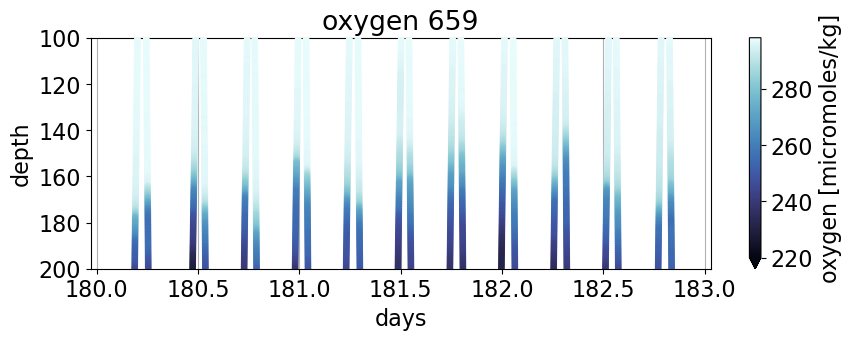

In [62]:
g3 = gproc.trim(gp_659, 180,183)
fig = plt.figure(figsize=(10,3))
ax = fig.gca()
g3.plot.scatter('days','depth', hue='oxygen', cmap=palettes[v], s=15, zorder=3, vmin=220)
ax.invert_yaxis()
ax.margins(x=0.01)

# ax.set_xticks(np.arange(180,196,1))
plt.grid(visible=True, axis='x', zorder=0)
ax.set_title('oxygen 659')
ax.set_ylim([200, 100])

# for label in ax.xaxis.get_ticklabels()[::2]:
#     label.set_visible(False)

In [ ]:
plot_var(gproc.trim(gp_659,124,127), var='oxygen_raw', size=30)
plot_var(gproc.trim(gp_659,124,127), var='oxygen', size=30)

# FSLE Satellite

In [5]:
file_path = '/Users/sangminsong/OneDrive - UW/Code/SOGOS/gridded-vars/'
fsle = xr.open_dataset(file_path + 'fsle_backwards.nc')
adt = xr.open_dataset(file_path + 'satellite_data.nc')

In [6]:
# %% 5. Zoom into high fsle dates with plotted ADT 
# This is how you do the animated maps 

# adt = satellite_data.adt
adt_sogos = sg.slice_sogos(adt.rename({'latitude':'lat', 'longitude':'lon'}),
                        datestart='2019-04-01', dateend='2019-09-01',
                        lat1=-54, lat2=-50,
                        lon1=32, lon2=39)

ds = dav_659
# fname = 'figures/zoomADT_660_yd'
figtitle = 'glider 659 yd='
# savefig = True

# if you want all dates above a threshold
# cutoff = -.4
# ind = np.where(ds.fsle<cutoff)
# days = pd.unique(ds.days[ind].round())

# if you want to select the dates; eddy:[187,194)
days = np.arange(182,184,1)  # add 3 days either side

for day in days:
    plt.figure(figsize=(8, 6))
    adt_sogos.sel(time=sg.ytd2datetime(day)).plot(cmap=cmo.solar, vmin=-1.03, vmax=-.4)

    ind = np.where(ds.days.round()==day)
    # print(ds.bfsle[ind].values)
    dailyavg_fsle = np.round(ds.bfsle[ind].values.min(), decimals=3)

    plt.title(figtitle + str(day) + ', fsle=' + str(dailyavg_fsle))

    i = np.where(ds.days.round()==day)
    
    plt.plot(ds.longitude, ds.latitude, linewidth=3, color='w', alpha=0.3)
    plt.scatter(ds.longitude[i], ds.latitude[i], 20, color='w')
    plt.tight_layout()
    # if savefig:
    #     plt.savefig(fname + str(day), format='png')

NameError: name 'dav_659' is not defined

# Figures FSLE ADT

In [28]:
# iso_659 = np.linspace(26.8,27.8,1001)  
# gi_659 = gproc.transform_dataset(gp_659, iso_659, vars = ['SA', 'CT', 'oxygen', 'oxygen_raw', 'P', 'buoyancy']) 

# iso_660 = np.linspace(26.9,28.0,1001)
# gi_660 = gproc.transform_dataset(gp_660, iso_660,  vars = ['SA', 'CT', 'oxygen', 'oxygen_raw', 'P', 'buoyancy'])

In [33]:
size = 32
params = {'legend.fontsize': 24, \
          'xtick.labelsize':size, \
          'ytick.labelsize':size, \
          'font.size':size,
          'font.family':'Futura'}
plt.rcParams.update(params)

In [44]:
ship_data = pd.read_csv(file_path + 'ShipData_DF.csv', index_col=[0])
float_data = pd.read_csv(file_path + 'FloatData_DF.csv', index_col=[0])

# np.where(float_data.Yearday.values.round()==190)
# float_data = float_data[float_data.Yearday<209]
# fsle.sel(time='2019-05-01')

In [84]:
conda install -c conda-forge cartopy

Solving environment: done

## Package Plan ##

  environment location: /Users/sangminsong/opt/anaconda3/envs/sogos_22

  added / updated specs:
    - cartopy


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    cartopy-0.18.0             |   py37hf1ba7ce_1         1.7 MB
    openssl-1.1.1s             |       hfd90126_0         1.9 MB  conda-forge
    proj-6.2.1                 |       h773a61f_0        10.0 MB  conda-forge
    pyshp-2.3.1                |     pyhd8ed1ab_0         941 KB  conda-forge
    shapely-1.8.4              |   py37ha3a5ccb_0         318 KB
    ------------------------------------------------------------
                                           Total:        14.8 MB

The following NEW packages will be INSTALLED:

  cartopy            pkgs/main/osx-64::cartopy-0.18.0-py37hf1ba7ce_1 None
  geos               pkgs/main/osx-64::geos-3.8.0-hb1e8313_0 None
  proj        

In [96]:
    # Create a feature for States/Admin 1 regions at 1:50m from Natural Earth
    states_provinces = cfeature.NaturalEarthFeature(
        category='cultural',
        name='admin_1_states_provinces_lines',
        scale='50m',
        facecolor='none')

    SOURCE = 'Natural Earth'
    LICENSE = 'public domain'

    ax.add_feature(cfeature.LAND)
    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(states_provinces, edgecolor='gray')

    # Add a text annotation for the license information to the
    # the bottom right corner.
    text = AnchoredText(r'$\mathcircled{{c}}$ {}; license: {}'
                        ''.format(SOURCE, LICENSE),
                        loc=4, prop={'size': 12}, frameon=True)
    ax.add_artist(text)

    plt.show()


<xarray.Dataset>
Dimensions:    (lat: 161, lon: 160)
Coordinates:
    time       datetime64[ns] 2019-05-25
  * lat        (lat) float32 -64.88 -64.62 -64.38 ... -25.38 -25.12 -24.88
  * lon        (lon) float32 10.12 10.38 10.62 10.88 ... 49.12 49.38 49.62 49.88
Data variables:
    adt        (lat, lon) float64 ...
    ugos       (lat, lon) float64 ...
    vgos       (lat, lon) float64 ...
    vgosa      (lat, lon) float64 ...
    err        (lat, lon) float64 ...
    err_vgosa  (lat, lon) float64 ...
    err_ugosa  (lat, lon) float64 ...
    sla        (lat, lon) float64 ...
    ugosa      (lat, lon) float64 ...
Attributes:
    Conventions:                     CF-1.6
    Metadata_Conventions:            Unidata Dataset Discovery v1.0
    cdm_data_type:                   Grid
    comment:                         Sea Surface Height measured by Altimetry...
    contact:                         servicedesk.cmems@mercator-ocean.eu
    creator_email:                   servicedesk.cmems@mercator-ocean.eu
    creator_name:                    CMEMS - Sea Level Thematic Assembly Center
    creator_url:                     http://marine.copernicus.eu
    date_created:                    2021-11-14T23:44:55Z
    date_issued:                     2021-11-14T23:44:55Z
    date_modified:                   2021-11-14T23:44:55Z
    geospatial_lat_max:              -24.875
    geospatial_lat_min:              -74.875
    geospatial_lat_resolution:       0.25
    geospatial_lat_units:            degrees_north
    geospatial_lon_max:              59.875
    geospatial_lon_min:              0.125
    geospatial_lon_resolution:       0.25
    geospatial_lon_units:            degrees_east
    geospatial_vertical_max:         0.0
    geospatial_vertical_min:         0.0
    geospatial_vertical_positive:    down
    geospatial_vertical_resolution:  point
    geospatial_vertical_units:       m
    history:                         2021-11-14 23:44:56Z: Creation
    institution:                     CLS, CNES
    keywords:                        Oceans > Ocean Topography > Sea Surface ...
    keywords_vocabulary:             NetCDF COARDS Climate and Forecast Stand...
    license:                         http://marine.copernicus.eu/web/27-servi...
    platform:                        Altika, Cryosat-2 New Orbit, Haiyang-2B,...
    processing_level:                L4
    product_version:                 vMay2021
    project:                         COPERNICUS MARINE ENVIRONMENT MONITORING...
    references:                      http://marine.copernicus.eu
    software_version:                18.7.3_DUACS_DT2018_baseline
    source:                          Altimetry measurements
    ssalto_duacs_comment:            Jason-3 is the reference mission used fo...
    standard_name_vocabulary:        NetCDF Climate and Forecast (CF) Metadat...
    summary:                         SSALTO/DUACS Near-Real-Time Level-4 sea ...
    time_coverage_duration:          P1D
    time_coverage_end:               2021-11-15T12:00:00Z
    time_coverage_resolution:        P1D
    time_coverage_start:             2021-11-14T12:00:00Z
    title:                           NRT merged all satellites Global Ocean G...
    History:                         Translated to CF-1.0 Conventions by Netc...

AttributeError: 'GeoAxesSubplot' object has no attribute '_autoscaleXon'

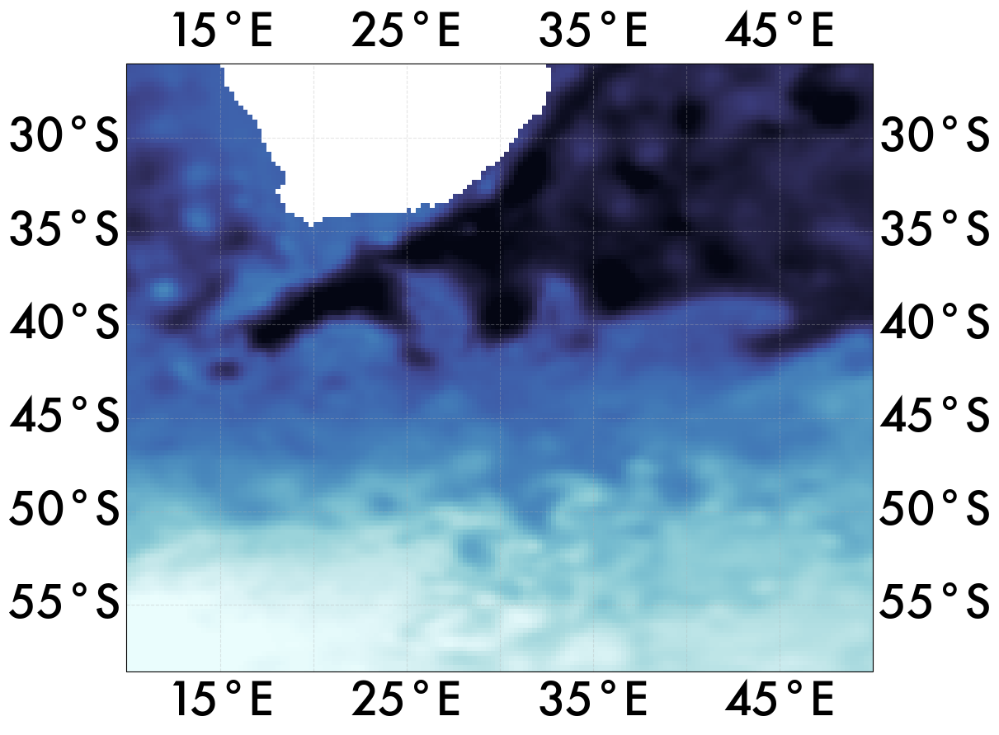

In [8]:
# *** STUDY REGION ***
adt_sg= sg.slice_sogos(adt.rename({'latitude':'lat', 'longitude':'lon'}),
                        datestart='2019-04-01', dateend='2019-09-01',
                        lat1=-60, lat2=-20,
                        lon1=0, lon2=60)
                        
daylist = np.arange(144,145,1)
for day in daylist:
    plt.figure(figsize=(12,11), constrained_layout=True)
    ax = plt.axes(projection=ccrs.PlateCarree())

    gl = ax.gridlines(draw_labels=True,alpha=0.33, linestyle='--')
    ax.set_extent([10,50,-57, -26])

    # adt_sogos.adt.attrs={'long_name':'ADT'}
    dat = adt_sg.sel(time=sg.ytd2datetime(day))
    map = dat.adt.plot(cmap=cmo.ice_r, vmin=-1.4)
    # ax.scatter(dat.lat.values, dat.lon, v=adt, cmap=cmo.ice_r)
    # dat.plot.scatter('lon', 'lat', hue='adt', cmap=cmo.ice_r, ax=ax, s=30, zorder=3)

    rect = patch.Rectangle((27, -56), 15, 8,
                        fill=False, color="k", linewidth=5)
    # ax.add_patch(rect)  
    ax.coastlines()
    ax.set_title('')
    # ax.set_ylabel('')
    # ax.set_ylim([-60, -20])
    # ax.set_xlabel('')
    # ax.set_xlim([10, 50])
    # ax.set_ymargin=0.1
    # data_crs = ccrs.PlateCarree()
    # ax.set_yticks(np.arange(-30, -57, 10), transform=data_crs)

    # cbar = fig.colorbar(map, ax=ax, orientation='vertical', shrink=0.5)
    ax.add_feature(cf.LAND, facecolor='lightgray')
    # cbar.ax.set_ylabel('ADT')
    # plt.plot(dav_659.lon[:-20], dav_659.lat[:-20], linewidth=3, color='r', alpha=.8)
    # plt.plot(dav_660.lon[:-20], dav_660.lat[:-20], linewidth=3, color='k', alpha=.8)


In [76]:
# Plot absolute dynamic topography from daily averages

# def plot_ADT(adt, datestr):

datestr = sg.ytd2datetime(145)
plt.figure(figsize=(12, 8))
adt.sel(time=datestr).plot(cmap=cmocean.cm.matter)

# Add rectangle for SWIR study region
rect = patch.Rectangle((20, -55), 20, 10,
                        fill=False, color="black", linewidth=1)
plt.gca().add_patch(rect)


ValueError: Dataset.plot cannot be called directly. Use an explicit plot method, e.g. ds.plot.scatter(...)

<Figure size 1200x800 with 0 Axes>

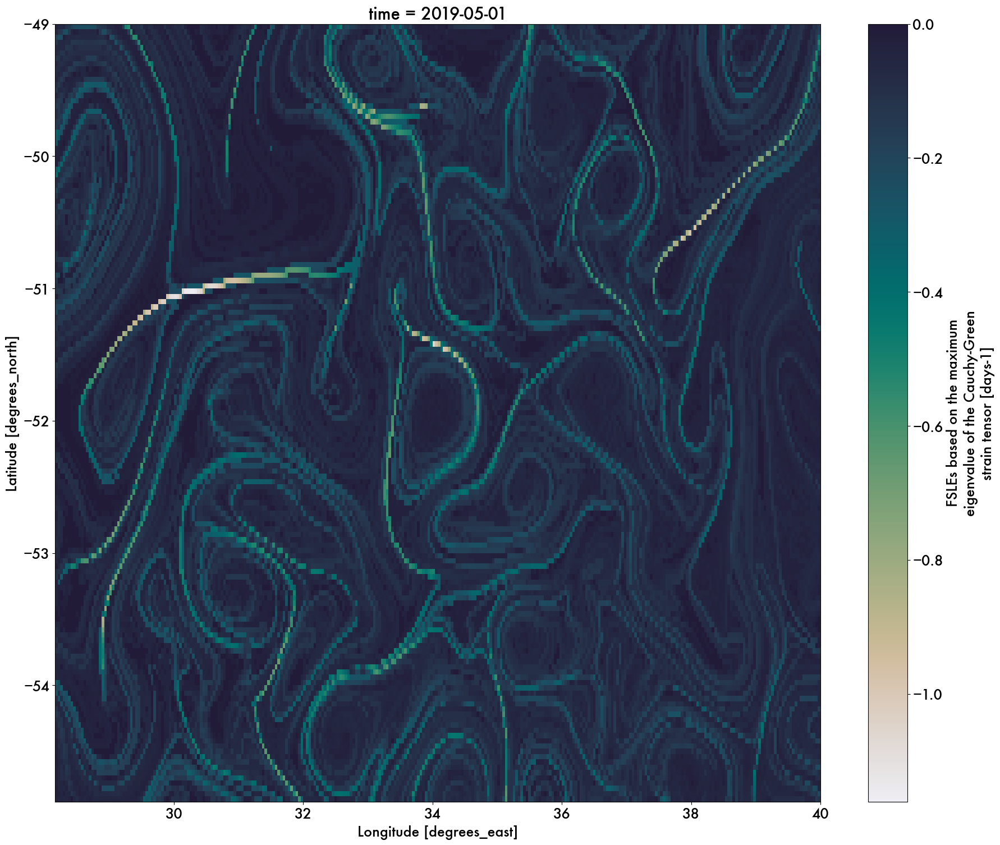

In [213]:
plt.figure(figsize=(22,18))
fsle.sel(time='2019-05-01').fsle_max.plot(cmap=cmo.rain)

In [31]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

In [191]:
fsle

<xarray.Dataset>
Dimensions:    (lat: 147, lon: 296, time: 89)
Coordinates:
  * lat        (lat) float32 -54.86 -54.82 -54.78 -54.74 ... -49.1 -49.06 -49.02
  * lon        (lon) float32 28.18 28.22 28.26 28.3 ... 39.86 39.9 39.94 39.98
  * time       (time) datetime64[ns] 2019-04-29 2019-04-30 ... 2019-07-26
Data variables:
    fsle_max   (time, lat, lon) float32 ...
    theta_max  (time, lat, lon) float32 ...
Attributes:
    cdm_data_type:              Grid
    Conventions:                CF-1.6
    standard_name_vocabulary:   http://cf-pcmdi.llnl.gov/documents/cf-standar...
    title:                      Backward-in-time, finite-size Lyapunov expone...
    summary:                    This dataset contains Backward-in-time FSLE p...
    separation:                 Initial separation in degrees: 0.02; Maximal ...
    comment:                    Surface product; submesoscale filaments
    contact:                    aviso@altimetry.fr
    geospatial_lat_min:         -89.98
    geospatial_lat_max:         89.98
    geospatial_lon_min:         0.02
    geospatial_lon_max:         359.98
    geospatial_vertical_min:    0.0
    geospatial_vertical_max:    0.0
    geospatial_lat_units:       degrees_north
    geospatial_lon_units:       degrees_east
    geospatial_lat_resolution:  0.04
    geospatial_lon_resolution:  0.04
    institution:                CNES, CLS, LOCEAN, CTOH
    license:                    http://www.aviso.altimetry.fr/fileadmin/docum...
    product_version:            1.0
    project:                    SSALTO/DUACS
    references:                 www.aviso.altimetry.fr
    end_time:                   2019-03-28 00:00:00
    start_time:                 2019-10-14 00:00:00
    time_coverage_resolution:   P4D
    EXTRA_DIMENSION.nv:         2

In [1]:
llcoords = [31,35.5,-52.5, -49]

# SINGLE GLIDER PATH FOR FSLE and pH SATELLITE COMPARISON

dav = dav_659
file_path = '/Users/sangminsong/OneDrive - UW/Code/SOGOS/scripts/working-figs/'
fname = 'ADTstudyregion_2glider_path_yd'
savefig = False
# savefig = True
fig = plt.figure(figsize=(10,8))
daylist = np.arange(145,146,1)
for day in daylist:
    fig = plt.figure(figsize=(10,7))
    dat = fsle.sel(time=sg.ytd2datetime(day))

    ax = plt.axes(projection=ccrs.PlateCarree())
    gl = ax.gridlines(draw_labels=True,alpha=0.33, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    ax.set_extent(llcoords)

    map = dat.fsle_max.plot(cmap=cmo.ice_r, ax=ax, transform=ccrs.PlateCarree(), add_colorbar=False)
    plt.plot(dav_659.lon, dav_659.lat, linewidth=8, color='r', alpha=0.6)
    i = np.where(dav_659.days.round()==day)
    plt.scatter(dav_659.lon[i], dav_659.lat[i], 140, color='w', label = '659')

    plt.title('sea surface (ADT)')
    plt.ylabel('')
    plt.xlabel('')

    # cax = divider.append_axes(position='right', size='5%', pad=0.05)
    # cax = fig.add_axes([ax.get_position().x1+0.04,ax.get_position().y0+.04,0.03,ax.get_position().height*.9])
    # cbar = plt.colorbar(map, cax)


NameError: name 'dav_659' is not defined

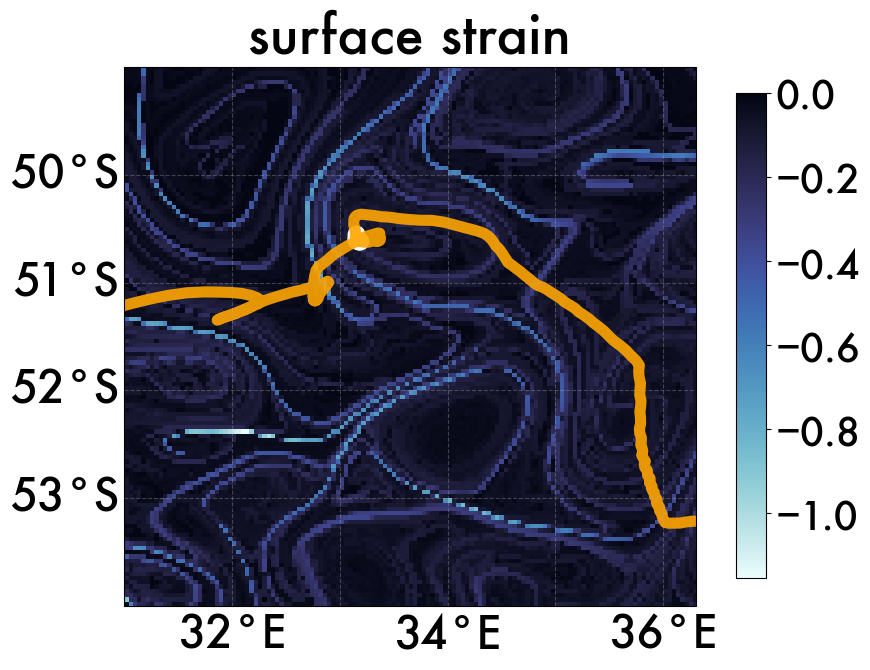

In [244]:
llcoords = [31,36.3,-54, -49]

# SINGLE GLIDER PATH FOR FSLE and pH SATELLITE COMPARISON

dav = dav_659
file_path = '/Users/sangminsong/OneDrive - UW/Code/SOGOS/scripts/working-figs/'
fname = 'ADTstudyregion_2glider_path_yd'
savefig = False
# savefig = True

daylist = np.arange(145,146,1)
for day in daylist:
    fig = plt.figure(figsize=(10,7))
    dat = fsle.sel(time=sg.ytd2datetime(day))

    ax = plt.axes(projection=ccrs.PlateCarree())
    gl = ax.gridlines(draw_labels=True,alpha=0.33, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    ax.set_extent(llcoords)

    map = dat.fsle_max.plot(cmap=cmo.ice_r, ax=ax, transform=ccrs.PlateCarree(), add_colorbar=False)
    plt.plot(dav_659.lon, dav_659.lat, linewidth=8, color='orange', alpha=0.9)
    i = np.where(dav_659.days.round()==day)
    plt.scatter(dav_659.lon[i], dav_659.lat[i], 140, color='w', label = '659')

    plt.title('surface strain')
    plt.ylabel('')
    plt.xlabel('')

    # cax = divider.append_axes(position='right', size='5%', pad=0.05)
    cax = fig.add_axes([ax.get_position().x1+0.04,ax.get_position().y0+.04,0.03,ax.get_position().height*.9])
    cbar = plt.colorbar(map, cax)
    cbar.ax.tick_params(labelsize=28) 

plt.show()
plt.close()
# Image(file_path + fname + str(120) + '.png') 

In [278]:
size = 50
params = {'legend.fontsize': size, 
          'xtick.labelsize':size, 
          'ytick.labelsize':size, 
          'font.size':size,
          'font.family':'Futura'}
plt.rcParams.update(params)

AttributeError: 'GeoAxesSubplot' object has no attribute '_autoscaleXon'

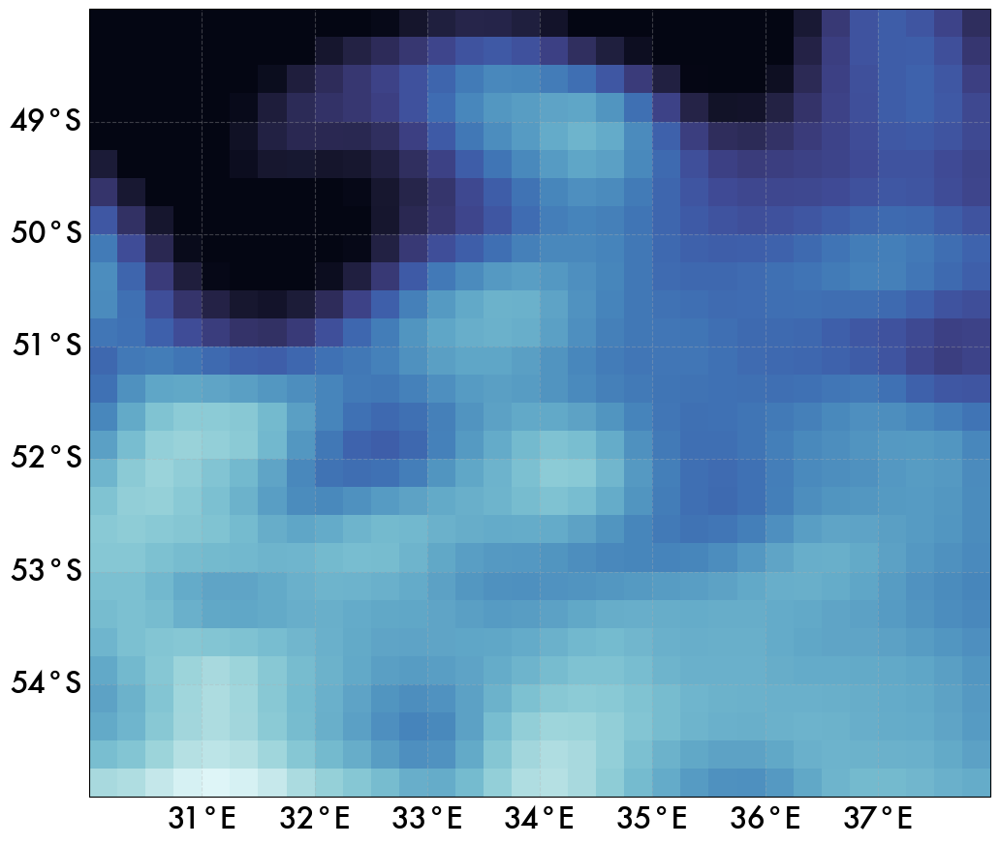

In [156]:
llcoords = [30,38,-55, -48]

# REFINE GIF PLOT GLIDERS PATH
# plot large scale satellite map with argo and both floats
adt_sogos = sg.slice_sogos(adt.rename({'latitude':'lat', 'longitude':'lon'}),
                        datestart='2019-04-01', dateend='2019-09-01',
                        lat1=llcoords[2], lat2=llcoords[3],
                        lon1=llcoords[0], lon2=llcoords[1])

dav = dav_659
file_path = '/Users/sangminsong/OneDrive - UW/Code/SOGOS/scripts/working-figs/'
fname = 'ADTregion_2glider_yd'
savefig = False
# savefig = True

# plt.rcParams.update(params)

daylist = np.arange(135,151,1)
for day in daylist:
    fig= plt.figure(figsize=(12,11))
    
    adt_sogos.adt.attrs={'long_name':'ADT'}
    dat = adt_sogos.sel(time=sg.ytd2datetime(day))

    ax = plt.axes(projection=ccrs.PlateCarree())
    gl = ax.gridlines(draw_labels=True,alpha=0.33, linestyle='--')
    gl.top_labels = False
    gl.right_labels = False
    ax.set_extent(llcoords)

    map = dat.adt.plot(cmap=cmo.ice_r, vmin=-1.2, vmax=-.2, ax=ax, add_colorbar=False)
    plt.plot(dav_659.lon, dav_659.lat, linewidth=14, color='r', alpha=0.5)
    plt.plot(dav_660.lon, dav_660.lat, linewidth=14, color='w', alpha=0.5)

    i = np.where(dav_659.days.round()==day)
    plt.scatter(dav_659.lon[i], dav_659.lat[i], 800, color='r', label = '659')
    i = np.where(dav_660.days.round()==day)
    plt.scatter(dav_660.lon[i], dav_660.lat[i], 800, color='w', label = '660')

    plt.legend(facecolor='white', labelcolor='white', framealpha=0.2, labelspacing=0.2, handletextpad=0.1)
    plt.title('sea surface (ADT)')
    plt.ylabel('')
    plt.xlabel('')

    # divider = make_axes_locatable(plt.gca())
    # cax = divider.append_axes(position='right', size='5%', pad=0.05)
    cax = fig.add_axes([ax.get_position().x1+0.04,ax.get_position().y0+.04,0.03,ax.get_position().height*.9])
    cbar = plt.colorbar(map, cax)
    # plt.show()

    # plt.tight_layout(pad=3)
    if savefig:
        plt.savefig(file_path + fname + str(day) + '.png', format='png', bbox_inches='tight', pad_inches=0.2)
        # plt.savefig(file_path + fname + str(day) + '.png', format='png')
        # plt.close()
    plt.close()
# Image(file_path + fname + str(day) +'.png') 

In [9]:
adt

<xarray.Dataset>
Dimensions:    (time: 154, latitude: 201, longitude: 240)
Coordinates:
  * time       (time) datetime64[ns] 2019-04-01 2019-04-02 ... 2019-09-01
  * latitude   (latitude) float32 -74.88 -74.62 -74.38 ... -25.38 -25.12 -24.88
  * longitude  (longitude) float32 0.125 0.375 0.625 0.875 ... 59.38 59.62 59.88
Data variables:
    adt        (time, latitude, longitude) float64 ...
    ugos       (time, latitude, longitude) float64 ...
    vgos       (time, latitude, longitude) float64 ...
    vgosa      (time, latitude, longitude) float64 ...
    err        (time, latitude, longitude) float64 ...
    err_vgosa  (time, latitude, longitude) float64 ...
    err_ugosa  (time, latitude, longitude) float64 ...
    sla        (time, latitude, longitude) float64 ...
    ugosa      (time, latitude, longitude) float64 ...
Attributes: (12/45)
    Conventions:                     CF-1.6
    Metadata_Conventions:            Unidata Dataset Discovery v1.0
    cdm_data_type:                   Grid
    comment:                         Sea Surface Height measured by Altimetry...
    contact:                         servicedesk.cmems@mercator-ocean.eu
    creator_email:                   servicedesk.cmems@mercator-ocean.eu
    ...                              ...
    time_coverage_duration:          P1D
    time_coverage_end:               2021-11-15T12:00:00Z
    time_coverage_resolution:        P1D
    time_coverage_start:             2021-11-14T12:00:00Z
    title:                           NRT merged all satellites Global Ocean G...
    History:                         Translated to CF-1.0 Conventions by Netc...

In [31]:
grouped

,rounded_yearday,lat,lon
0,120.0,-51.355,30.208
1,125.0,-51.074,32.828
2,135.0,-52.452,31.764
3,140.0,-51.856,33.445
4,145.0,-51.417,34.669
5,150.0,-51.576,35.332
6,155.0,-52.204,35.413
7,160.0,-52.743,34.407
8,165.0,-53.360,35.171
9,170.0,-53.617,36.474


In [51]:
import seaborn as sns

## MAP FOR UNDERGRAD

In [97]:
sogos = floatDF[floatDF.wmoid==5906030]

In [98]:
# Get daily float locations for the argo float 
sgfloat = sogos.copy()
sgfloat['rounded_yearday'] = np.floor(sgfloat['yearday'])

# Group by the rounded 'yearday' and calculate the averages of 'latitude' and 'longitude'
grouped = sgfloat.groupby('rounded_yearday').agg({'lat': 'mean', 'lon': 'mean'}).reset_index()

# Create a new DataFrame 'new_df' with the rounded 'yearday', averaged latitude, and averaged longitude
sgfloat = grouped.rename(columns={'rounded_yearday': 'yearday'})
sgfloat['yearday'] = sgfloat['yearday'].astype(int)
sgfloat

,yearday,lat,lon
0,120,-51.355,30.208
1,125,-51.074,32.828
2,135,-52.452,31.764
3,140,-51.856,33.445
4,145,-51.417,34.669
...,...,...,...
58,650,-57.037,63.757
59,660,-57.064,64.008
60,671,-57.102,64.260
61,681,-57.315,64.442


In [ ]:
# axis text formatting resource

# ax.plot([0,1],[-35,30])
# ax.yaxis.set_major_formatter(EngFormatter(unit=u"°C"))

# ax2.plot([0,1],[-35,30])
# ax2.yaxis.set_major_formatter(StrMethodFormatter(u"{x:.0f} °C"))

In [124]:
dav_659.to_dataframe()

,u_dive,v_dive,u_surface,v_surface,lat,lon,days,mld,bfsle
dive,,,,,,,,,
0,0.548,0.590,60.745998,47.698002,-51.492599,30.052999,NaN,NaN,-0.035231
1,0.614,0.625,69.255997,54.123001,-51.477501,30.084000,NaN,NaN,-0.054554
2,0.612,0.577,75.292000,65.344002,-51.444901,30.153000,119.588869,50.0,-0.164127
3,0.613,0.465,78.598000,60.272999,-51.417900,30.222000,119.625918,105.0,-0.218893
4,0.568,0.283,79.470001,41.248001,-51.386799,30.326000,119.699158,169.0,-0.243799
...,...,...,...,...,...,...,...,...,...
458,-0.013,0.194,26.351999,49.618999,-46.292099,66.179001,205.111624,214.0,NaN
459,0.060,0.191,21.455999,9.791000,-46.250401,66.246002,205.326192,195.0,NaN
460,0.057,0.171,46.876999,23.660999,-46.210499,66.323997,205.540516,209.0,NaN


In [134]:
np.where(diveave_659.days.round()==day)
diveave_659.days.loc[7]

120.13576496160516

In [128]:
diveave_659 = dav_659.to_dataframe()
diveave_659 = diveave_659[diveave_659.days<200]

diveave_660 = dav_660.to_dataframe()
diveave_660 = diveave_660[diveave_660.days<200]

In [235]:
# diveave = diveave_660
file_path = '/Users/sangminsong/Library/CloudStorage/OneDrive-UW/Code/SOGOS-ML/figures/'
fname = 'sg660_fullpath_yd'
savefig = True
# savefig=False

# plt.rcParams.update(params)

daylist = np.arange(120, 201, 1)
for day in daylist:
    plt.figure(figsize=(14, 9))
    
    adt_sogos.adt.attrs={'long_name':'ADT'}
    dat = adt_sogos.sel(time=sg.ytd2datetime(day))
    map = dat.adt.plot(cmap=cmo.ice_r, vmin=-1.2, vmax=-.15, zorder=1)

    ticklist = np.arange(-1.2, -.2, .02)
    cax = fig.add_axes([ax.get_position().x1+0.04,ax.get_position().y0,0.03,ax.get_position().height])
    cbar = plt.colorbar(map, ax=cax, ticks=ticklist)
    cbar.set_label('ADT (m)')


    plt.title('sg660, yearday ' + str(day))
    plt.plot(diveave_660.lon, diveave_660.lat, linewidth=12, color='w', alpha=0.4, zorder=3)
    # plt.plot(float_data.Longitude, )

    i = np.where(diveave_660.days.round()==day)
    # plt.scatter(diveave_660.lon.iloc[i], diveave_660.lat.iloc[i], 130, color='w', alpha=1, label = 'Seaglider 660', zorder=4)
    plt.scatter(diveave_660.lon.iloc[i], diveave_660.lat.iloc[i], 200, color='w', label = '660', zorder=3, alpha=1, edgecolors='k')

    
    ax=plt.gca()
    # ax.set_yticks(np.arange(-49,-53.1,-1))

    ax.set_ylim([-55.7, -47.7])
    ax.set_xlim([29.1, 39.1])
    # ax.set_aspect('equal')
    ax.yaxis.set_major_formatter("{x:1.0f}°S")
    ax.xaxis.set_major_formatter("{x:1.0f}°E")
    
    plt.ylabel('')
    plt.xlabel('')
    # plt.legend(facecolor='white', labelcolor='white', framealpha=0)

    plt.tight_layout()
    if savefig:
        plt.savefig(file_path + fname + str(day), format='png')
        # print('saved')
        plt.close()

In [1]:
# Full deployment gif: evising with yearday label and expanding plotted region. 09282023
# All gliders and float data
adt_sogos = sg.slice_sogos(adt.rename({'latitude':'lat', 'longitude':'lon'}),
                        datestart='2019-04-01', dateend='2019-09-01',
                        lat1=-56.5, lat2=-45,
                        lon1=27, lon2=45)

file_path = '/Users/sangminsong/Library/CloudStorage/OneDrive-UW/Code/SOGOS-ML/figures/'
fname = 'sg660_paths_labeled_yd'
# savefig = False
savefig = True

pal = sns.color_palette("PuRd", 10)
hue659 = 'w' #pal[8]
hue660 = pal[6]


# plt.rcParams.update(params)

daylist = np.arange(120,201,1)
# daylist = np.arange(140,143,1)
for day in daylist:
    fig = plt.figure(figsize=(14,8))
    adt_sogos.adt.attrs={'long_name':'ADT'}
    dat = adt_sogos.sel(time=sg.ytd2datetime(day))
    map = dat.adt.plot(cmap=cmo.ice_r, vmin=-1.2, vmax=-.15, zorder=1)

    # ticklist = np.arange(-1.2, -.2, .02)
    # cax = fig.add_axes([ax.get_position().x1+0.04,ax.get_position().y0,0.03,ax.get_position().height])
    # cbar = plt.colorbar(map, ax=cax, ticks=ticklist)
    # cbar.set_label('ADT (m)')

    plt.title('Yearday ' + str(day))
    # plt.title('')

    # Plot glider paths
    plt.plot(diveave_659.lon, diveave_659.lat, linewidth=9, color=hue659, alpha=0.7)
    plt.plot(diveave_660.lon, diveave_660.lat, linewidth=12, color=hue660, alpha=0.5)

    ax=fig.gca()
    ax.set_ylim([-55.7, -47.7])
    ax.set_xlim([29.1, 39.1])
    # ax.set_aspect('equal')
    ax.yaxis.set_major_formatter("{x:1.0f}°S")
    ax.xaxis.set_major_formatter("{x:1.0f}°E")

    # Plot points of glider on that day
    i = np.where(diveave_659.days.round()==day)
    plt.scatter(diveave_659.lon.iloc[i], diveave_659.lat.iloc[i], 400, color=hue659, label = '659', zorder=3, alpha=1, edgecolors='k') # marker='o', markeredgecolor='k')
    i = np.where(diveave_660.days.round()==day)
    plt.scatter(diveave_660.lon.iloc[i], diveave_660.lat.iloc[i], 400, color=hue660, label = '660', zorder=3, alpha=1, edgecolors='k')


    # Plot nearest argo float location
    dayfloat = sgfloat[sgfloat.yearday==(day // 5) * 5]  # use floor function to round day to nearest 5 day, to match argo
    plt.scatter(dayfloat.lon, dayfloat.lat, s=800, color='yellow', alpha=1, marker='D', edgecolors='k', label='argo', zorder=3)

    plt.ylabel('')
    plt.xlabel('')
    # plt.legend(facecolor='white', labelcolor='white', framealpha=0.2)


    plt.tight_layout()
    if savefig:
        plt.savefig(file_path + fname + str(day) + '.png', format='png')
        # print('saved')
        plt.close()

NameError: name 'sg' is not defined

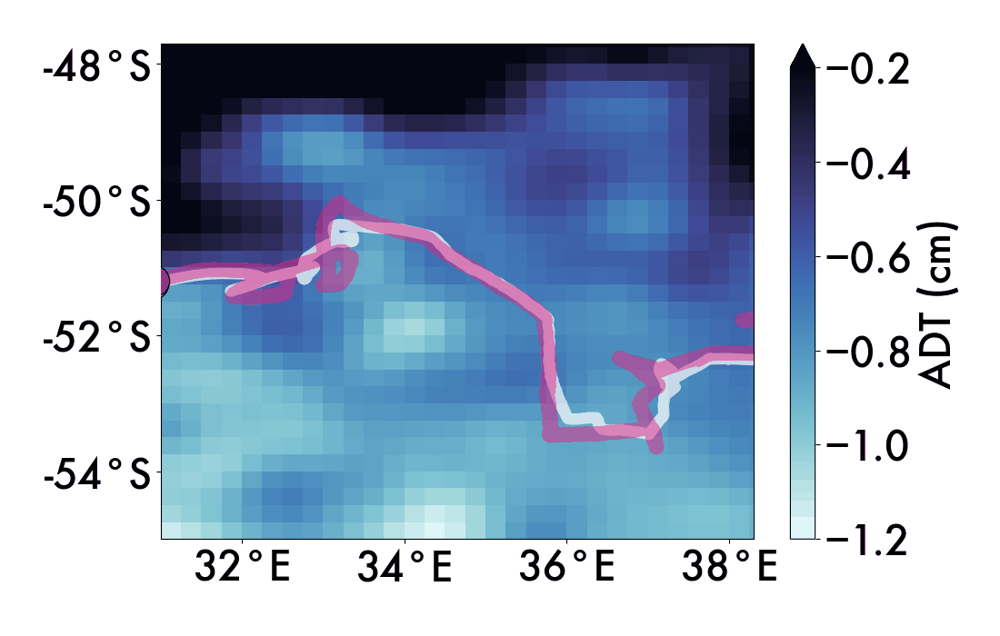

In [65]:
# from IPython.display import Image
gifname = 'ADT_allplat_path_yd'
png_dir = '/Users/sangminsong/Library/CloudStorage/OneDrive-UW/Code/SOGOS-ML/figures/'


images = []
for file_name in sorted(os.listdir(png_dir)):
    if file_name.startswith(gifname):
        file_path = os.path.join(png_dir, file_name)
        images.append(iio.imread(file_path))

# Make it pause at the end so that the viewers can ponder
for _ in range(10):
    images.append(iio.imread(file_path))

# Save them as frames into a gif 
exportname = png_dir + gifname + 'movie.gif'
kargs = { 'duration': .1 }
iio.mimsave(exportname, images, 'GIF', **kargs)

Image(png_dir + gifname + 'movie.gif') 
# Image(png_dir + 'adt_movie.gif')

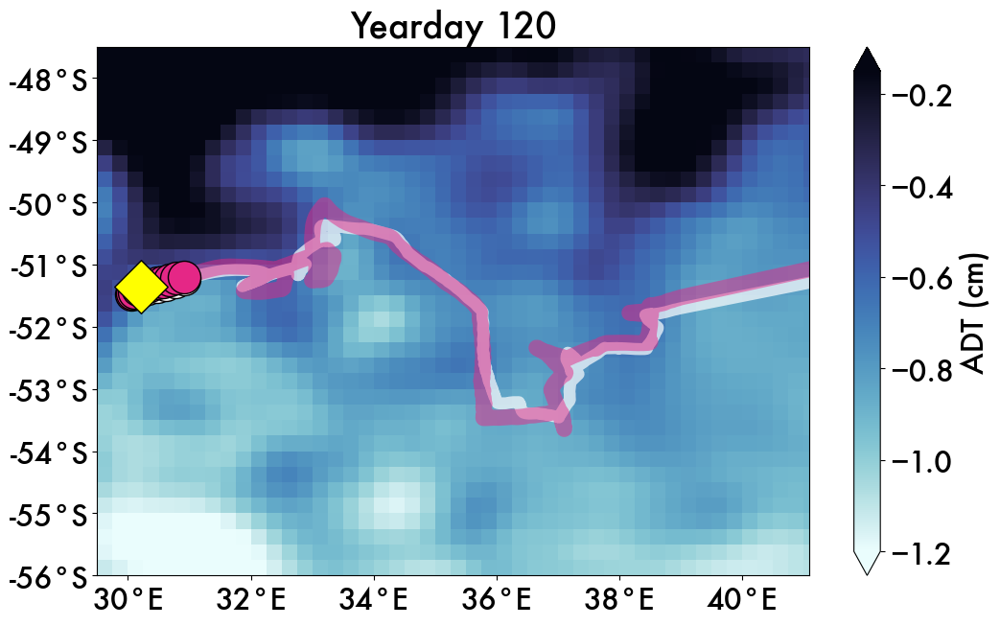

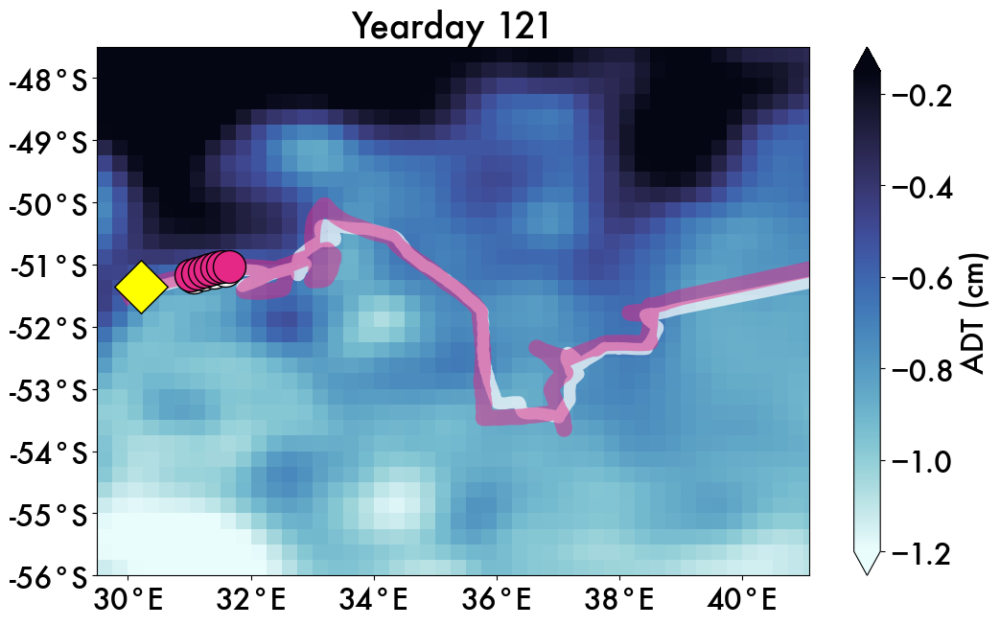

In [ ]:
# Old version: plot large scale satellite map with argo and both floats
adt_sogos = sg.slice_sogos(adt.rename({'latitude':'lat', 'longitude':'lon'}),
                        datestart='2019-04-01', dateend='2019-09-01',
                        lat1=-56.5, lat2=-45,
                        lon1=27, lon2=45)

diveave_659 = sg.slice_sogos(dav_659,
                        datestart='2019-04-01', dateend='2019-09-01',
                        lat1=-56.5, lat2=-45,
                        lon1=27, lon2=45)
diveave_660 = sg.slice_sogos(dav_660,
                        datestart='2019-04-01', dateend='2019-09-01',
                        lat1=-56.5, lat2=-45,
                        lon1=27, lon2=45)

file_path = '/Users/sangminsong/Library/CloudStorage/OneDrive-UW/Code/SOGOS-ML/figures/'
fname = 'adt_paths_labeled_yd'
savefig = False
# savefig = True

pal = sns.color_palette("PuRd", 10)
hue659 = 'w' #pal[8]
hue660 = pal[6]


# plt.rcParams.update(params)

daylist = np.arange(120,122,1)
# daylist = np.arange(140,143,1)
for day in daylist:
    fig = plt.figure(figsize=(11,7))
    ax = fig.gca()
    
    adt_sogos.adt.attrs={'long_name':'ADT (cm)'}
    dat = adt_sogos.sel(time=sg.ytd2datetime(day))
    
    map = dat.adt.plot(cmap=cmo.ice_r, vmin=-1.2, vmax=-.15, alpha=1.0)
    ax.set_ylim([-56.0, -47.5])
    ax.set_xlim([29.5, 41.1])
    ax.yaxis.set_major_formatter("{x:1.0f}°S")
    ax.xaxis.set_major_formatter("{x:1.0f}°E")

    # fig.colorbar(map, ax=ax, shrink=0.5).set_label('ADT')

    plt.title('Yearday ' + str(day))
    # plt.title('')

    # Plot glider paths
    plt.plot(dav_659.lon, dav_659.lat, linewidth=9, color=hue659, alpha=0.7)
    plt.plot(dav_660.lon, dav_660.lat, linewidth=12, color=hue660, alpha=0.5)


    # Plot points of glider on that day
    i = np.where(dav_659.days.round()==day)
    plt.scatter(dav_659.lon[i], dav_659.lat[i], 600, color=hue659, label = '659', zorder=3, alpha=1, edgecolors='k') # marker='o', markeredgecolor='k')
    i = np.where(dav_660.days.round()==day)
    plt.scatter(dav_660.lon[i], dav_660.lat[i], 600, color=hue660, label = '660', zorder=3, alpha=1, edgecolors='k')


    # Plot nearest argo float location
    dayfloat = sgfloat[sgfloat.yearday==(day // 5) * 5]  # use floor function to round day to nearest 5 day, to match argo
    plt.scatter(dayfloat.lon, dayfloat.lat, s=800, color='yellow', alpha=1, marker='D', edgecolors='k', label='argo', zorder=3)

    plt.ylabel('')
    plt.xlabel('')
    # plt.legend(facecolor='white', labelcolor='white', framealpha=0.2)


    plt.tight_layout()
    if savefig:
        plt.savefig(file_path + fname + str(day) + '.png', format='png')
        # print('saved')
        plt.close()

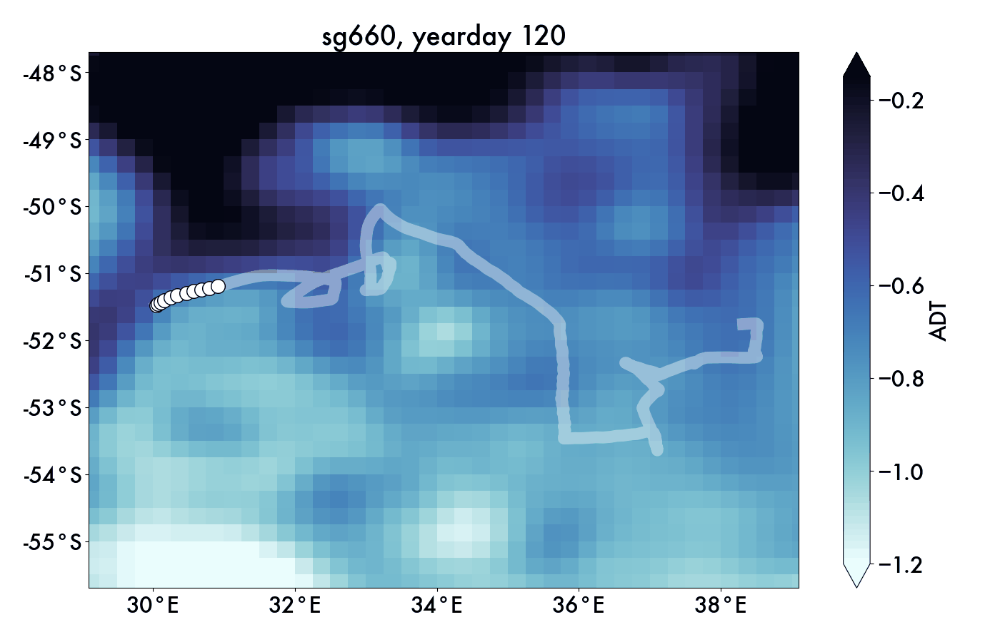

In [236]:
# from IPython.display import Image
gifname = 'sg660_fullpath_yd'
png_dir = '/Users/sangminsong/Library/CloudStorage/OneDrive-UW/Code/SOGOS-ML/figures/'


images = []
for file_name in sorted(os.listdir(png_dir)):
    if file_name.startswith(gifname):
        file_path = os.path.join(png_dir, file_name)
        images.append(iio.imread(file_path))

# Make it pause at the end so that the viewers can ponder
for _ in range(10):
    images.append(iio.imread(file_path))

# Save them as frames into a gif 
exportname = png_dir + gifname + 'movie_med.gif'
kargs = { 'duration': .2 }
iio.mimsave(exportname, images, 'GIF', **kargs)

Image(png_dir + gifname + 'movie_med.gif') 
# Image(png_dir + 'adt_movie.gif')

## Single glider gif

In [374]:
params = {'legend.fontsize': 12, \
          'xtick.labelsize':20, \
          'ytick.labelsize':20, \
          'font.size':22,
          'font.family':'Avenir'}
plt.rcParams.update(params)

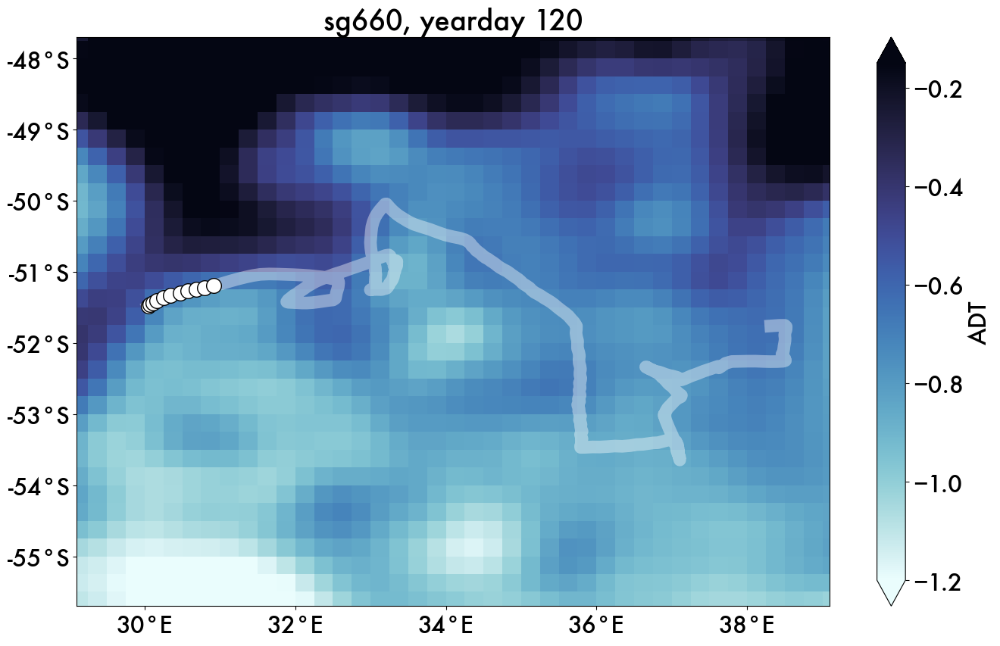

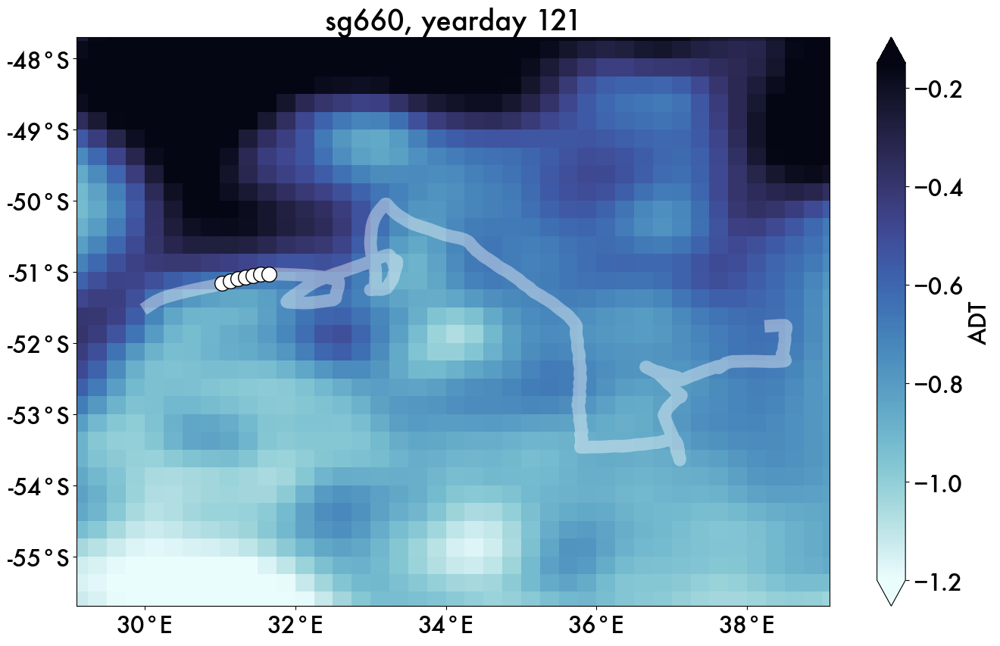

In [214]:
# plot large scale satellite map with ONE GLIDER
adt_sogos = sg.slice_sogos(adt.rename({'latitude':'lat', 'longitude':'lon'}),
                        datestart='2019-04-01', dateend='2019-09-01',
                        lat1=-56.5, lat2=-45,
                        lon1=27, lon2=45)


    # ax.set_ylim([-55.7, -47.7])
    # ax.set_xlim([29.1, 39.1])


# diveave = diveave_660
file_path = '/Users/sangminsong/Library/CloudStorage/OneDrive-UW/Code/SOGOS-ML/figures/'
fname = 'sg660_fullpath_yd'
# savefig = True
savefig=False

# plt.rcParams.update(params)

daylist = np.arange(120, 122, 1)
for day in daylist:
    plt.figure(figsize=(14, 9))
    
    adt_sogos.adt.attrs={'long_name':'ADT'}
    dat = adt_sogos.sel(time=sg.ytd2datetime(day))
    map = dat.adt.plot(cmap=cmo.ice_r, vmin=-1.2, vmax=-.15, zorder=1)

    ticklist = np.arange(-1.2, -.2, .02)
    cax = fig.add_axes([ax.get_position().x1+0.04,ax.get_position().y0,0.03,ax.get_position().height])
    cbar = plt.colorbar(map, ax=cax, ticks=ticklist)
    cbar.set_label('ADT (m)')


    plt.title('sg660, yearday ' + str(day))

    plt.plot(diveave_660.lon, diveave_660.lat, linewidth=12, color='w', alpha=0.4, zorder=3)
    # plt.plot(float_data.Longitude, )

    i = np.where(diveave_660.days.round()==day)
    # plt.scatter(diveave_660.lon.iloc[i], diveave_660.lat.iloc[i], 130, color='w', alpha=1, label = 'Seaglider 660', zorder=4)
    plt.scatter(diveave_660.lon.iloc[i], diveave_660.lat.iloc[i], 200, color='w', label = '660', zorder=3, alpha=1, edgecolors='k')


    # can label "glider path" and return for single fsle match up 
    

    # i = np.where(float_data.Yearday.values.round()==day)
    # if len(i)>0:
    #     plt.scatter(float_data.Longitude.loc.loc[i], float_data.Latitude.loc.loc[i], 50, color='y', label = 'Argo Float')

    ax=plt.gca()
    # ax.set_yticks(np.arange(-49,-53.1,-1))

    ax.set_ylim([-55.7, -47.7])
    ax.set_xlim([29.1, 39.1])
    # ax.set_aspect('equal')
    ax.yaxis.set_major_formatter("{x:1.0f}°S")
    ax.xaxis.set_major_formatter("{x:1.0f}°E")
    
    plt.ylabel('')
    plt.xlabel('')
    # plt.legend(facecolor='white', labelcolor='white', framealpha=0)

    plt.tight_layout()
    if savefig:
        plt.savefig(file_path + fname + str(day), format='png')
        # print('saved')
        plt.close()

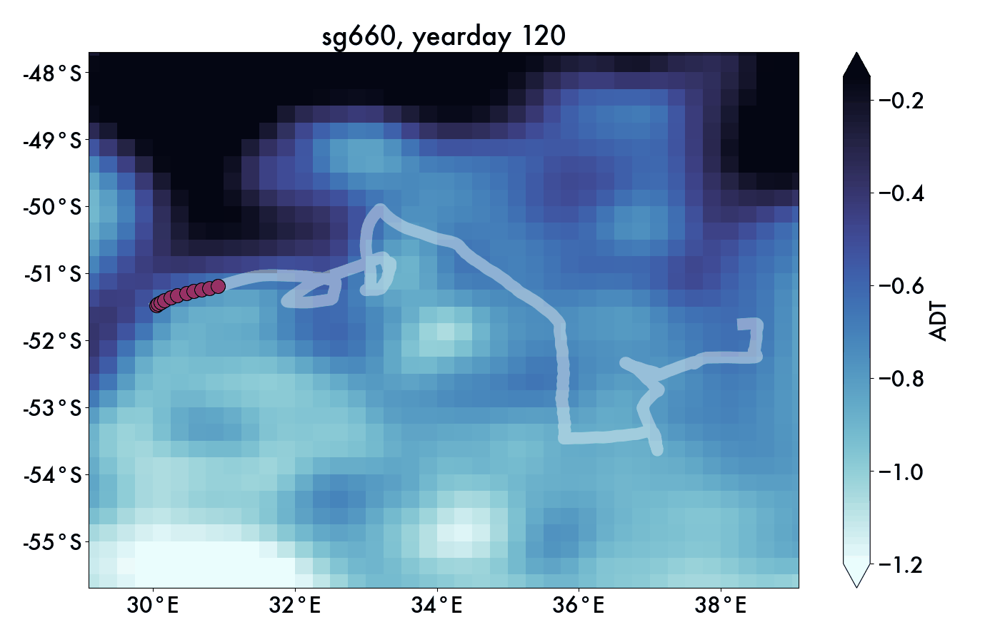

In [204]:
from IPython.display import Image
png_dir = '/Users/sangminsong/Library/CloudStorage/OneDrive-UW/Code/SOGOS-ML/figures/'
images = []
for file_name in sorted(os.listdir(png_dir)):
    if file_name.startswith('sg660_fullpath_yd'):
        file_path = os.path.join(png_dir, file_name)
        images.append(iio.imread(file_path))

# Make it pause at the end so that the viewers can ponder
# for _ in range(10):
#     images.append(iio.imread(file_path))

# Save them as frames into a gif 
exportname = png_dir + 'sg600_movie.gif'
kargs = { 'duration': .2}
iio.mimsave(exportname, images, 'GIF', **kargs)

Image(exportname) 
# Image(png_dir + 'adt_movie.gif')

## FSLE

In [194]:
# make pngs for gif of fsle


daylist = np.arange(120,140,1)
file_path = '/Users/sangminsong/OneDrive - UW/Code/SOGOS/scripts/working-figs/animation/'
savefig=True
fname = 'FSLE_2glider_shortyd'
# Plot along track FSLE values, both along-track and buffered, over time

for day in daylist:
    fig = plt.figure(figsize=(10,4), constrained_layout=True)
    ax=plt.axes()
    plt.grid()
    
    ax.plot(dav_659.days, dav_659.bfsle, linewidth=2, alpha=0.4, c='r')
    ax.plot(dav_660.days, dav_660.bfsle, linewidth=2, alpha=0.4, c='k')


    i = np.where(dav_659.days.round()==day)
    plt.scatter(dav_659.days[i], dav_659.bfsle[i], 50, color='r', label='Along-Track FSLE 659')
    i = np.where(dav_660.days.round()==day)
    plt.scatter(dav_660.days[i], dav_660.bfsle[i], 50, color='k', label='Along-Track FSLE 660')

    # i = np.where(dav_660.days.round()==day)
    # ax.plot(dav_660.days[i], dav_660.bfsle[i],linewidth=5, alpha=0.6, color='k', label='Along-Track FSLE 660')
    # i = np.where(dav_659.days.round()==day)
    # ax.plot(dav_659.days[i], dav_659.bfsle[i], linewidth=5, alpha=0.6, color='r', label='Along-Track FSLE 659')


    plt.xlabel('yearday')
    ax.set_xticks(np.arange(120,210,10))
    ax.margins(x=0.01)
    plt.ylabel('')
    # plt.title('Along-Track FSLE (Strain)')

    ax.legend()

    if savefig:
        plt.savefig(file_path + fname + str(day), format='png')
        # print('saved')
        plt.close()


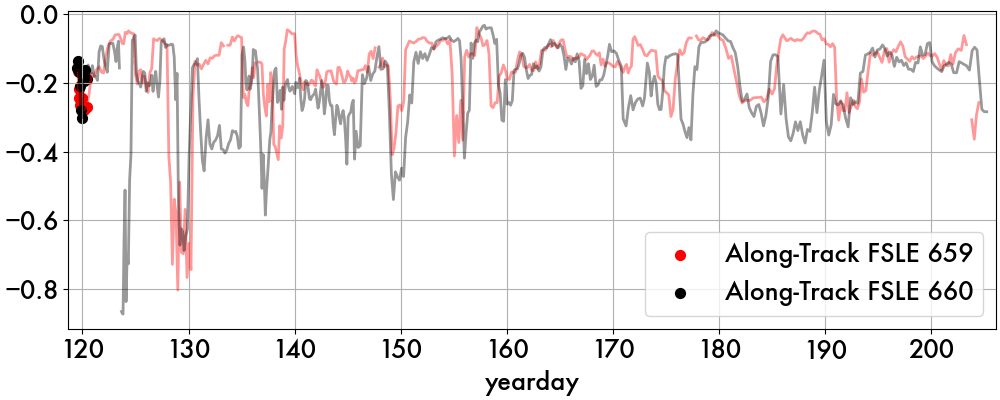

In [193]:
# show gif of flse
png_dir ='/Users/sangminsong/Library/CloudStorage/OneDrive-UW/Code/SOGOS/scripts/working-figs/animation/'
images = []
for file_name in sorted(os.listdir(png_dir)):
    if file_name.startswith('FSLE_2glider_short'):
        file_path = os.path.join(png_dir, file_name)
        images.append(iio.imread(file_path))

# Make it pause at the end so that the viewers can ponder
# for _ in range(10):
#     images.append(iio.imread(file_path))

# Save them as frames into a gif 
exportname = png_dir + 'FSLE_2glider_shortmovie.gif'
kargs = { 'duration': .15 }
iio.mimsave(exportname, images, 'GIF', **kargs)

Image(png_dir + 'FSLE_2glider_shortmovie.gif') 
# Image(png_dir + 'adt_movie.gif')

<Figure size 1000x400 with 0 Axes>

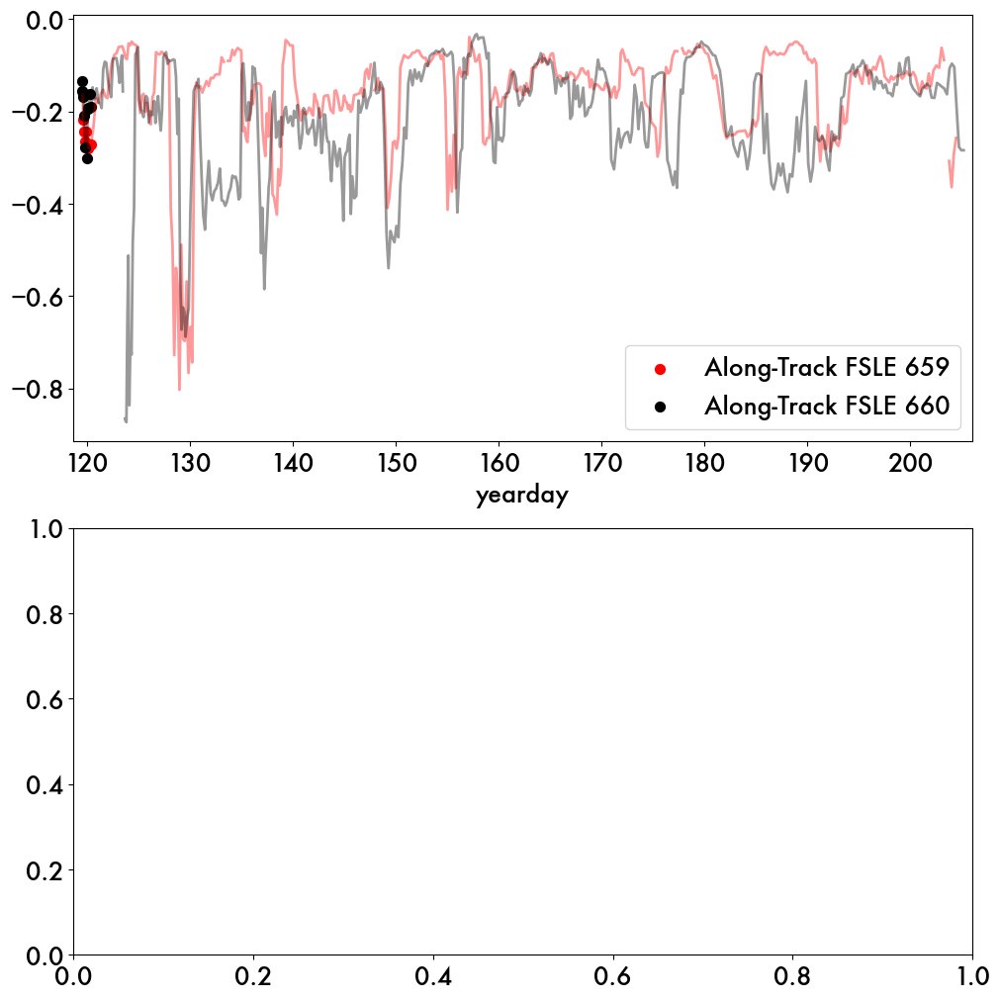

<Figure size 1000x400 with 0 Axes>

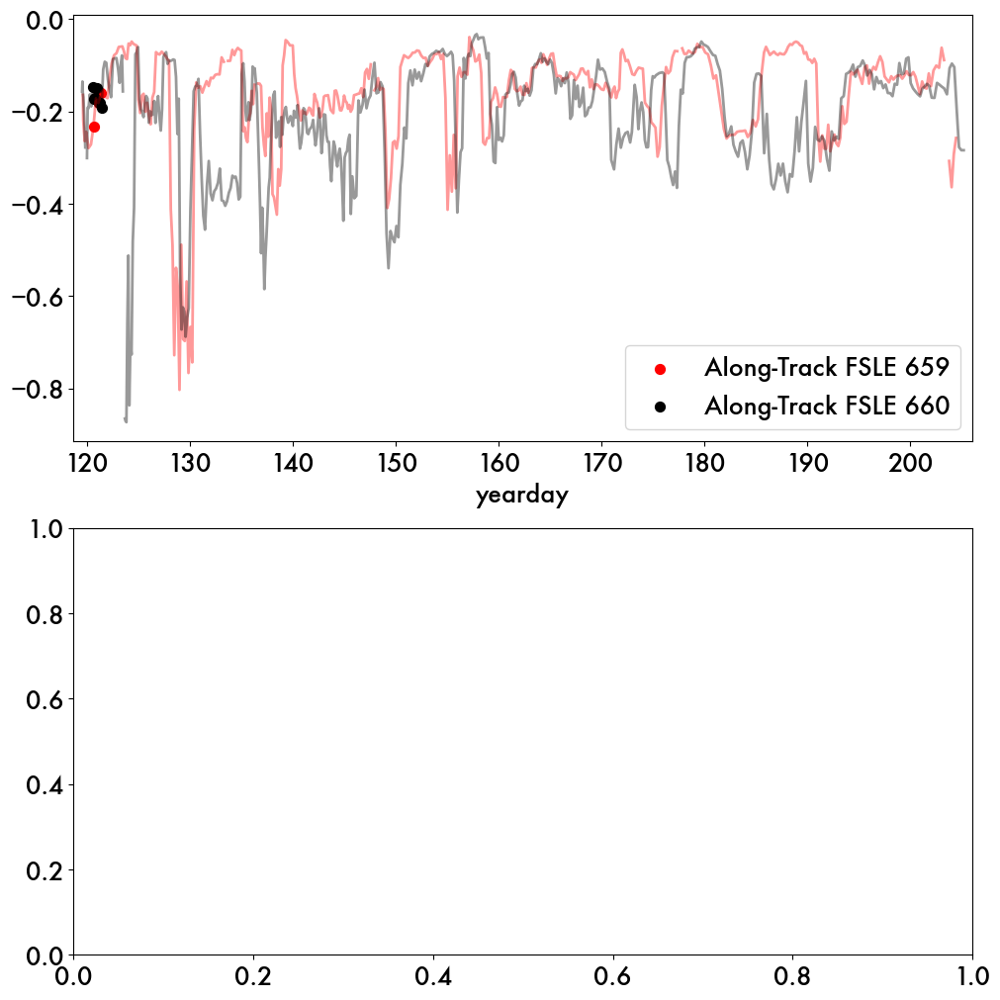

<Figure size 1000x400 with 0 Axes>

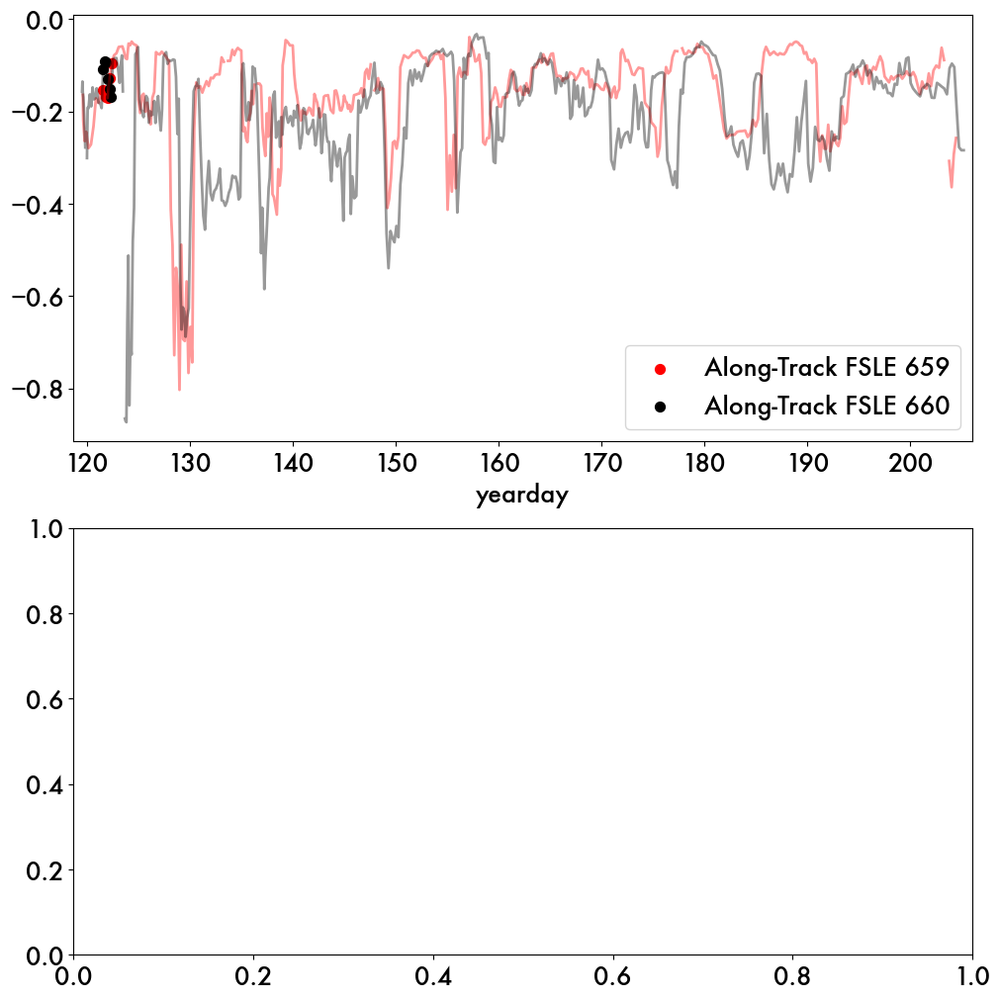

<Figure size 1000x400 with 0 Axes>

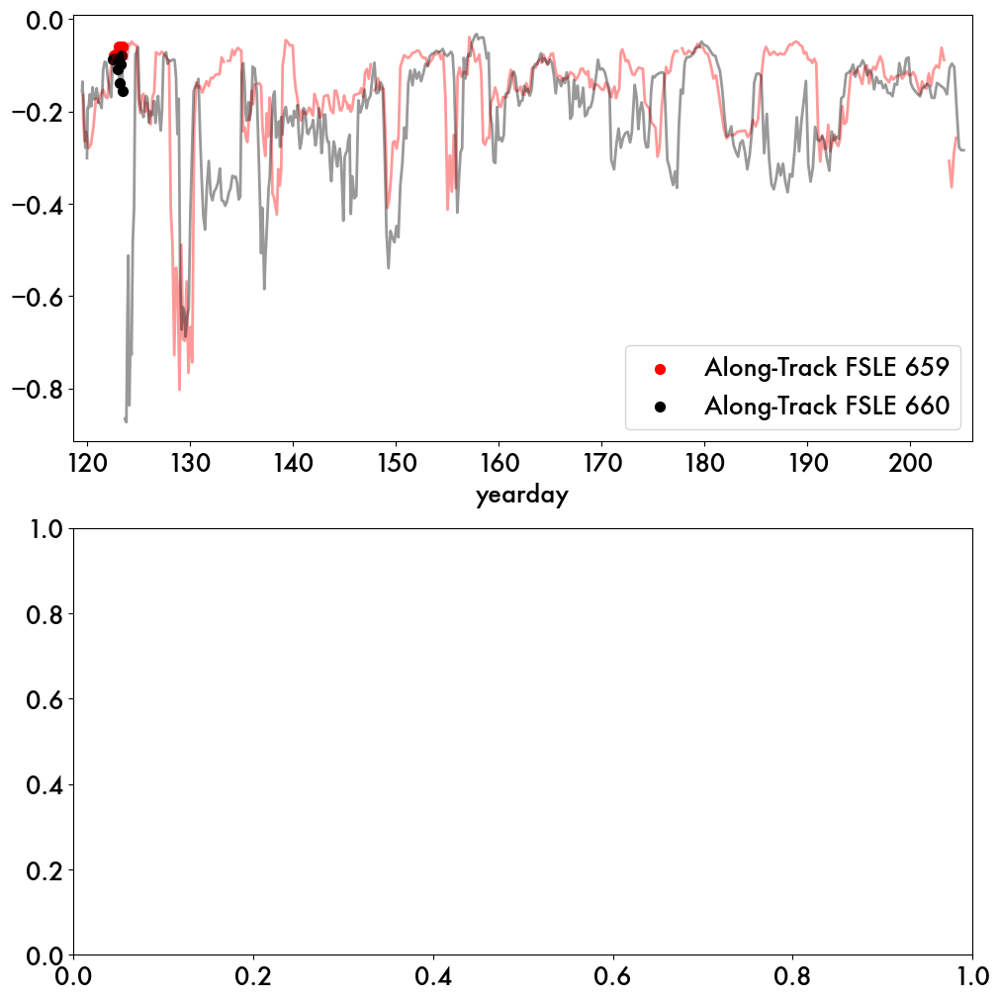

<Figure size 1000x400 with 0 Axes>

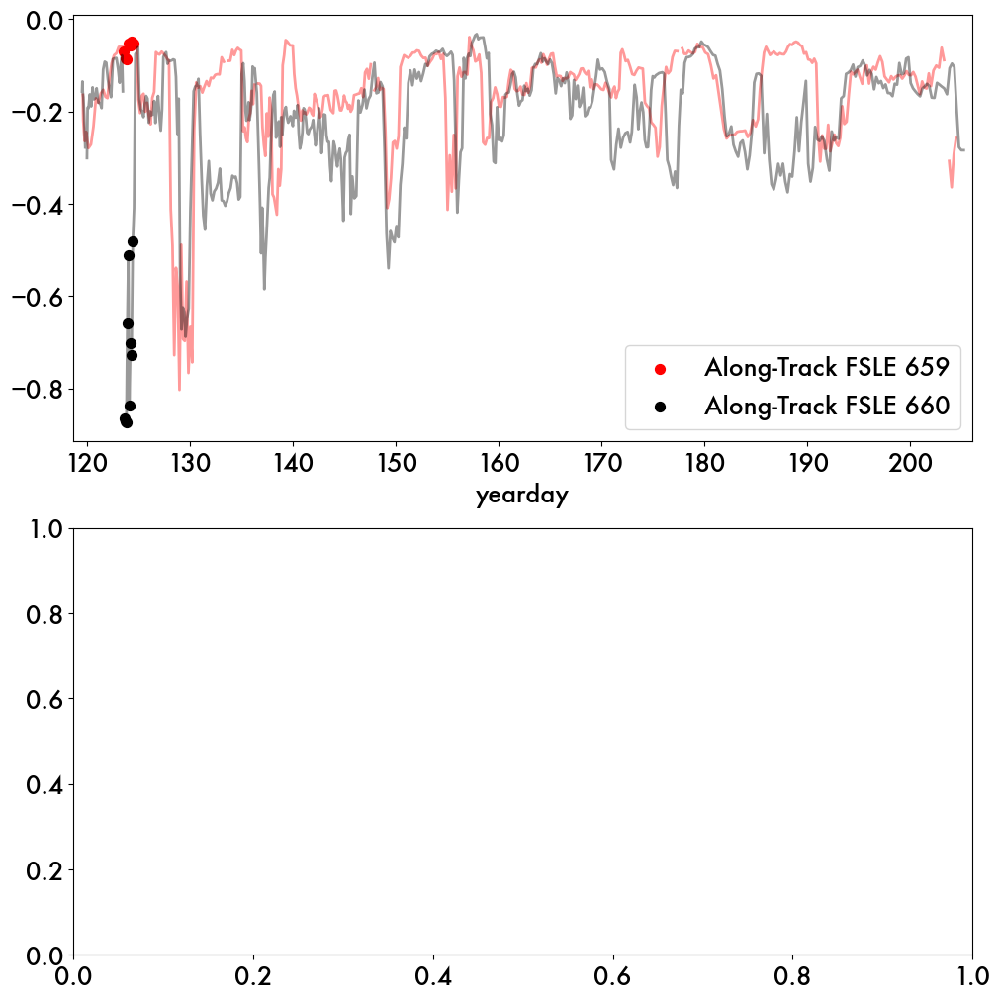

<Figure size 1000x400 with 0 Axes>

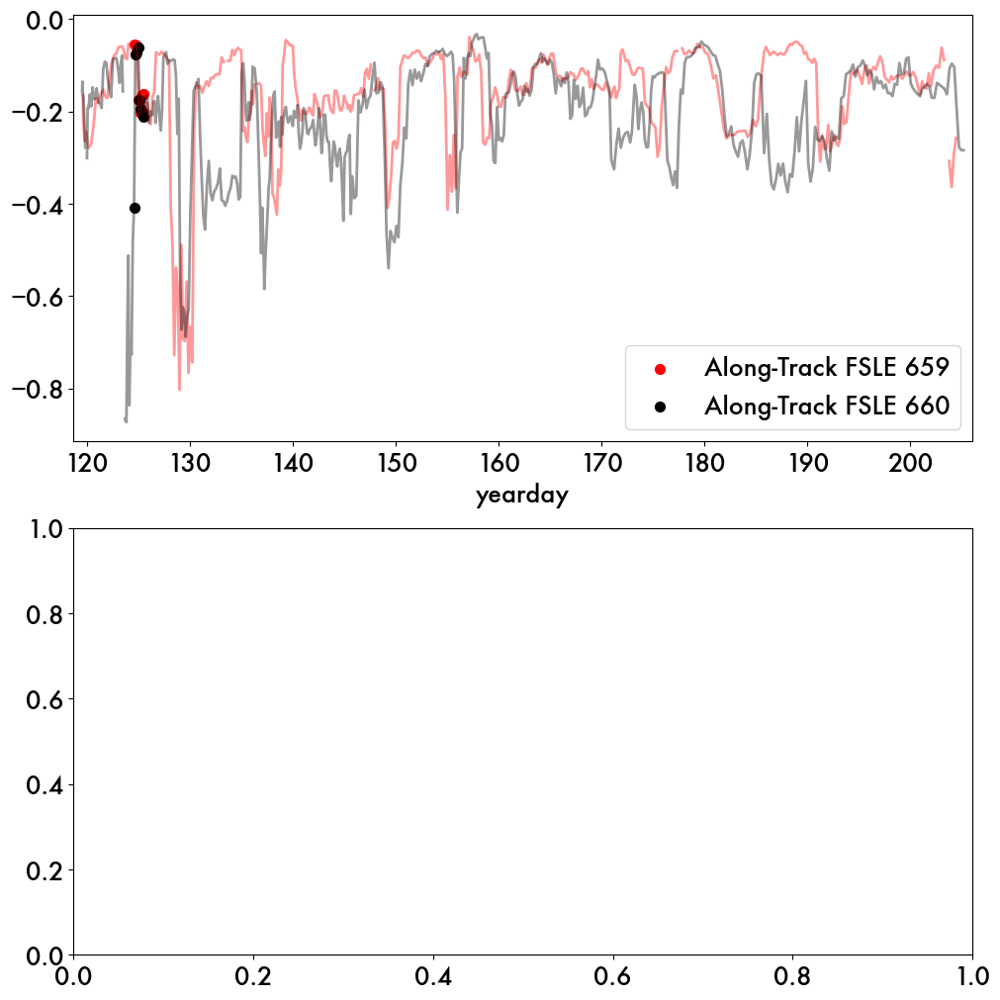

<Figure size 1000x400 with 0 Axes>

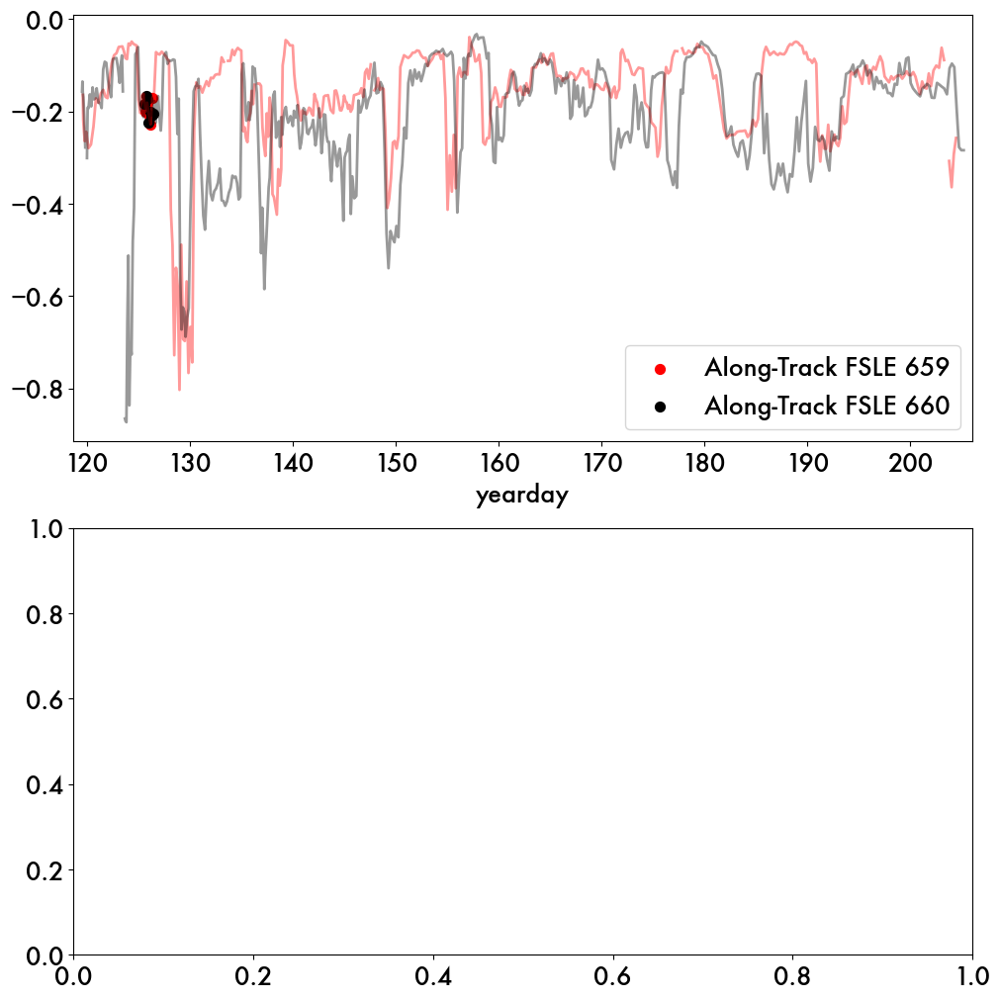

<Figure size 1000x400 with 0 Axes>

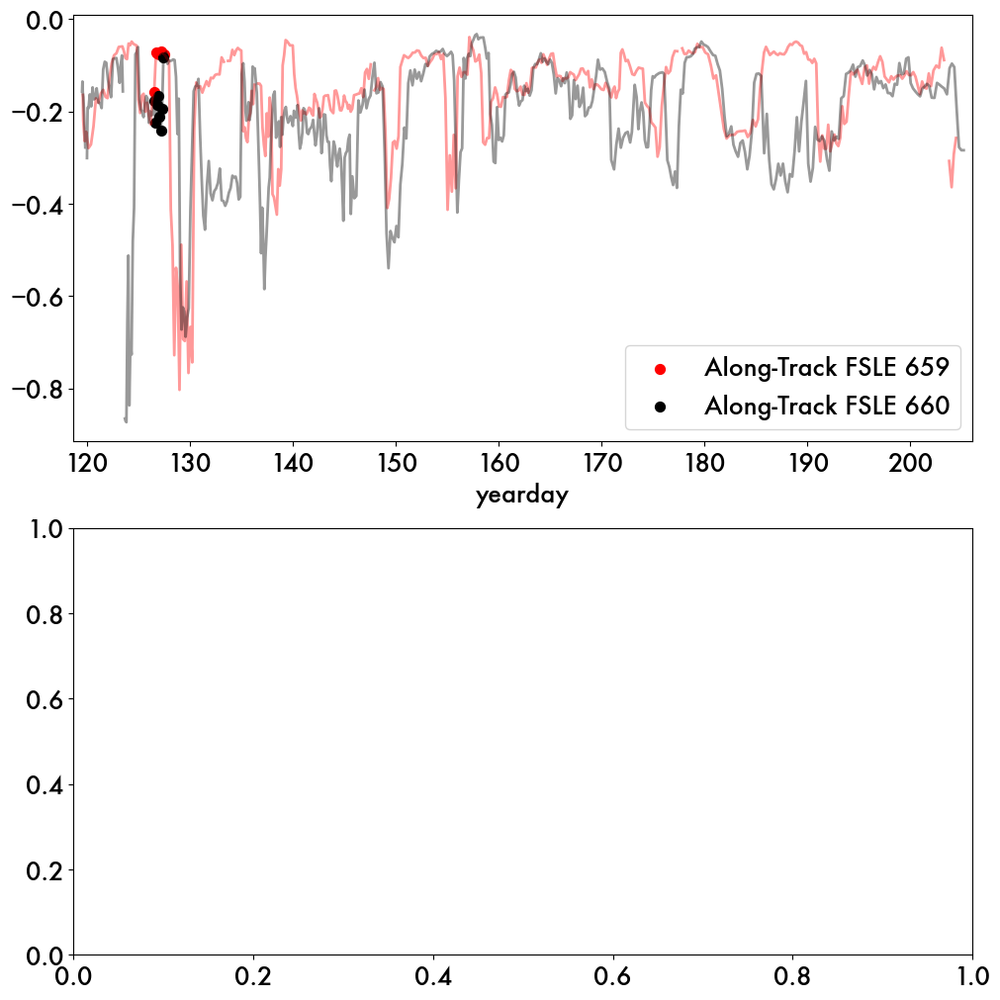

<Figure size 1000x400 with 0 Axes>

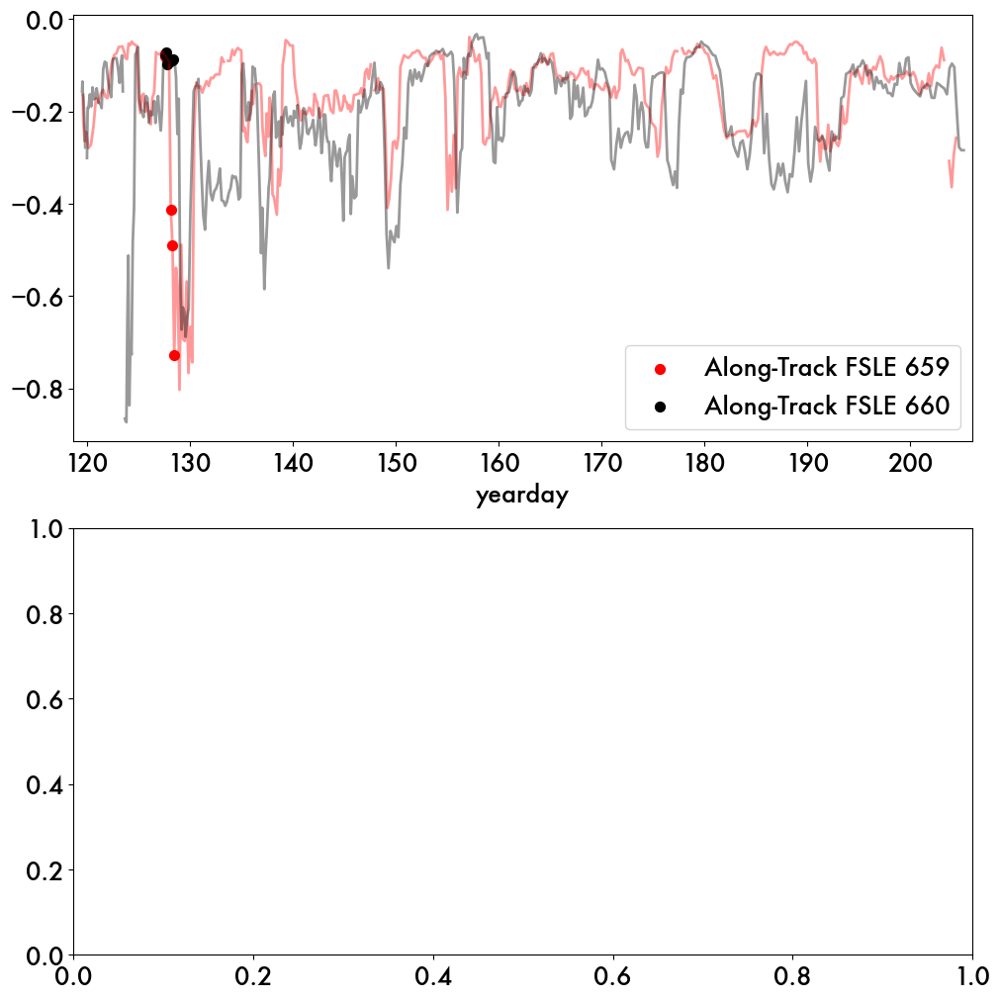

<Figure size 1000x400 with 0 Axes>

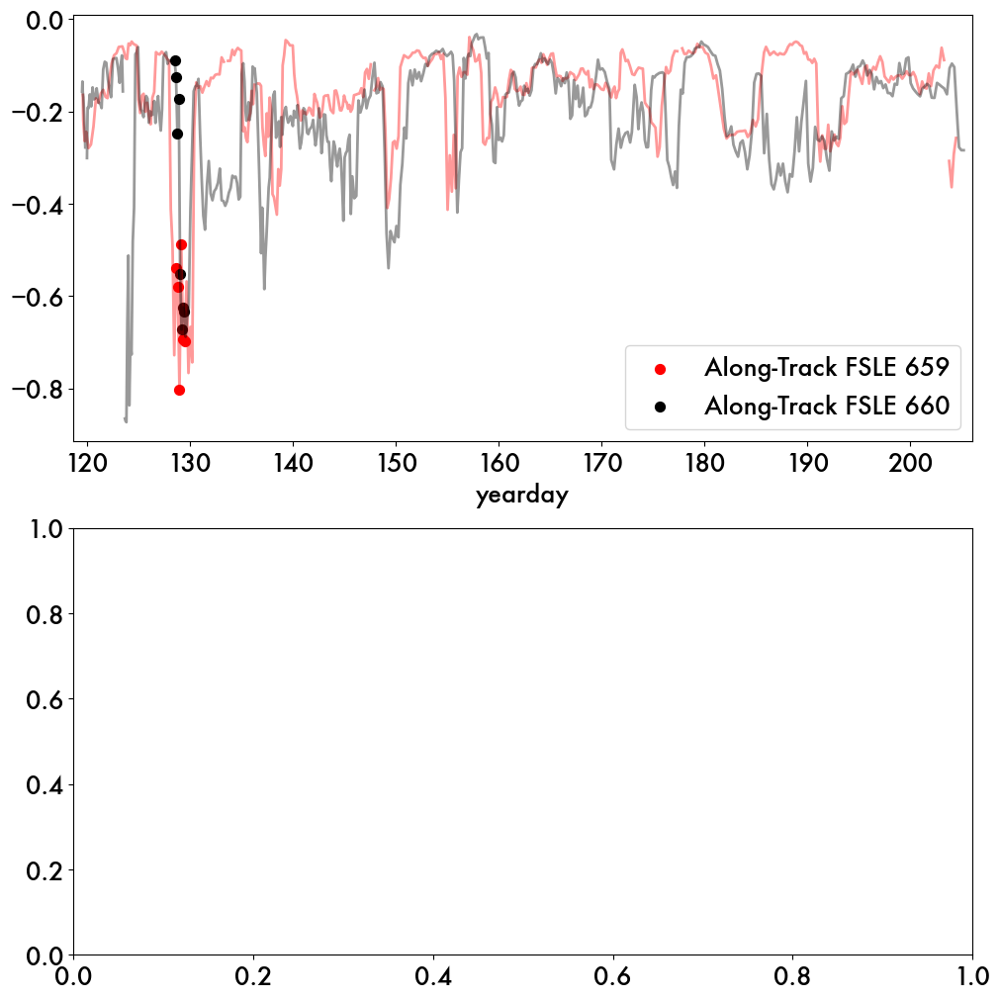

<Figure size 1000x400 with 0 Axes>

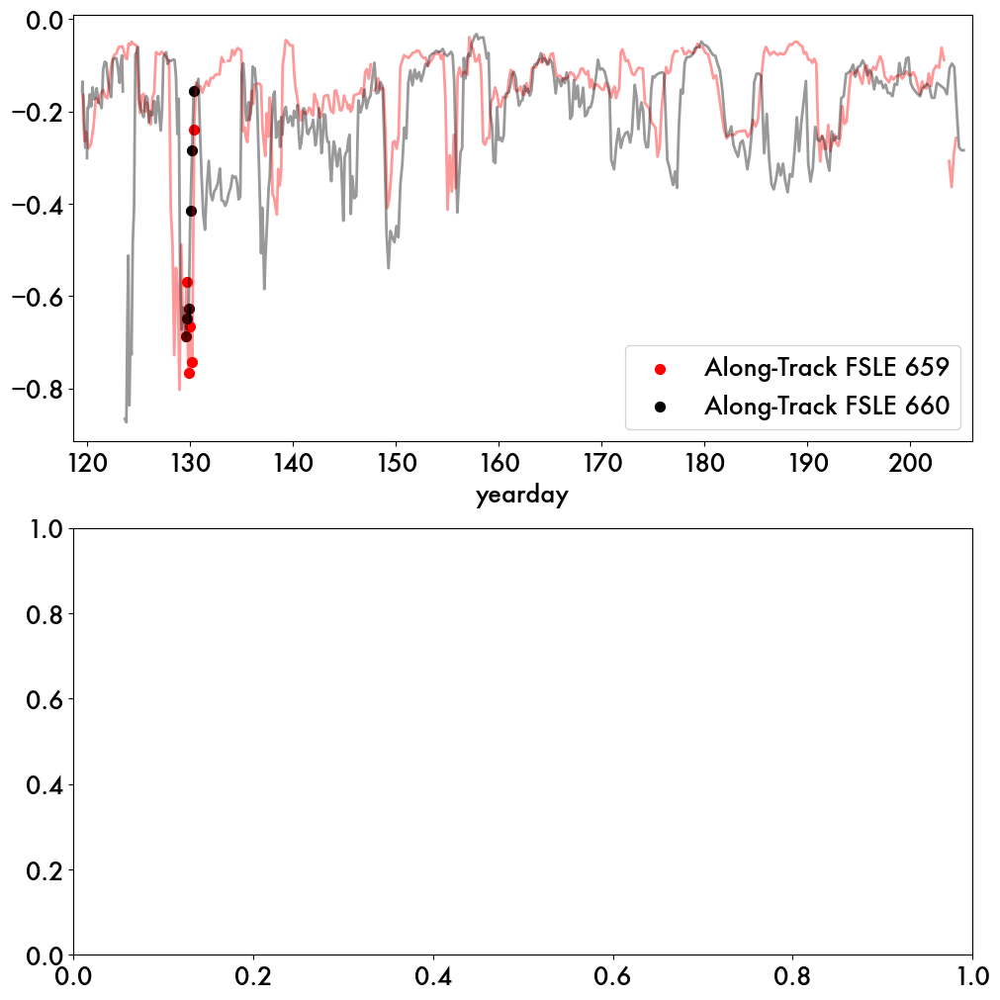

<Figure size 1000x400 with 0 Axes>

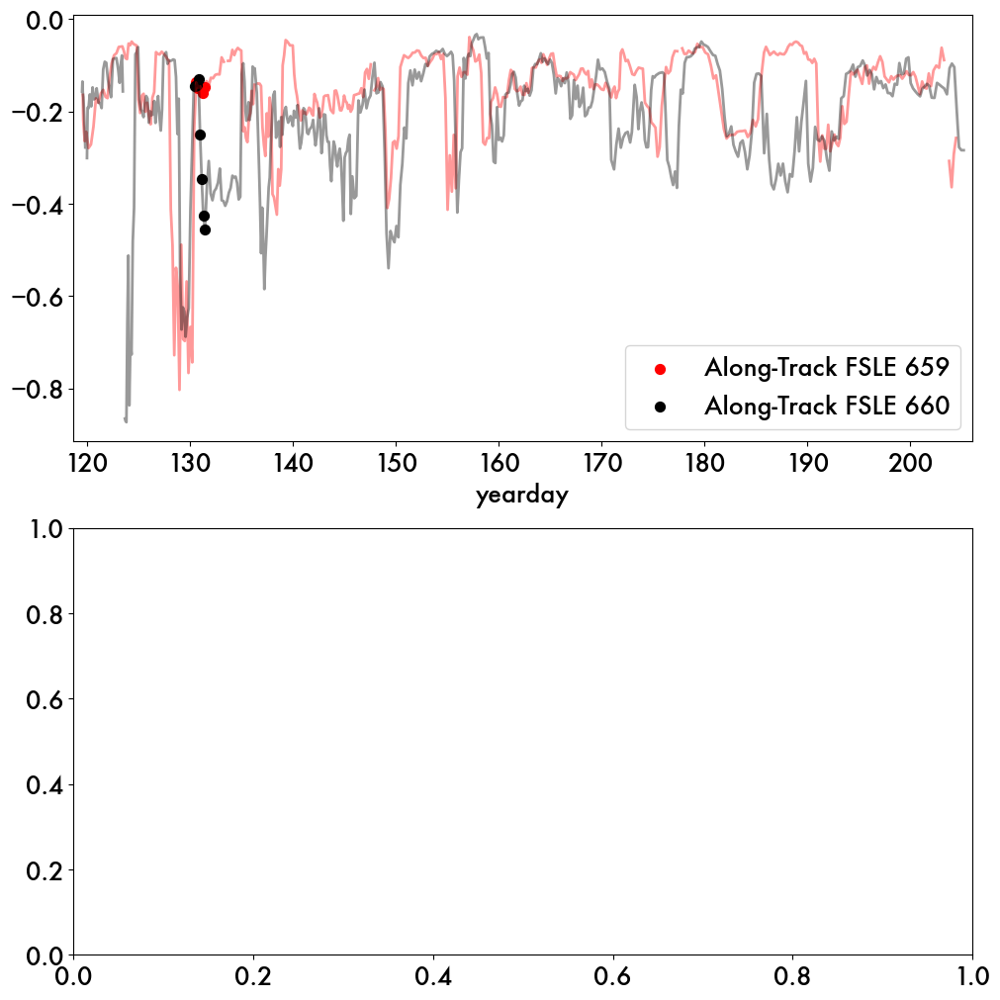

<Figure size 1000x400 with 0 Axes>

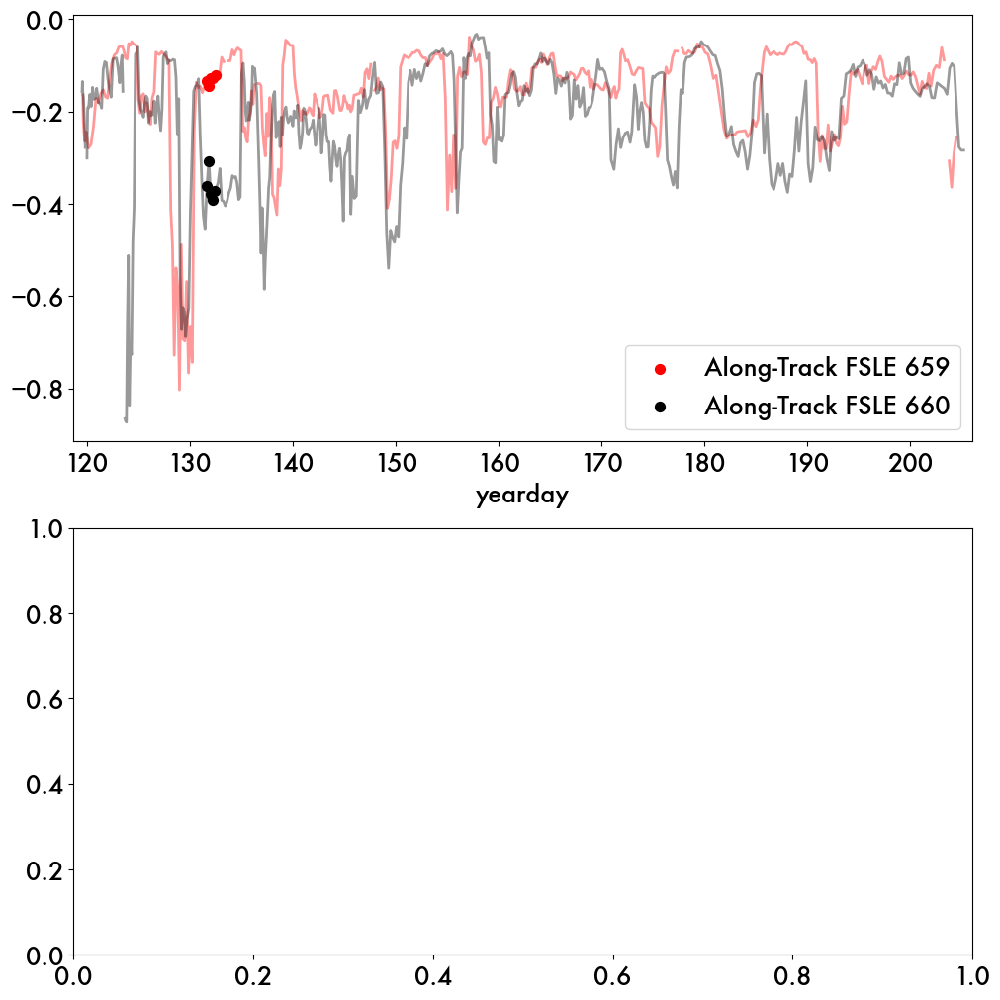

<Figure size 1000x400 with 0 Axes>

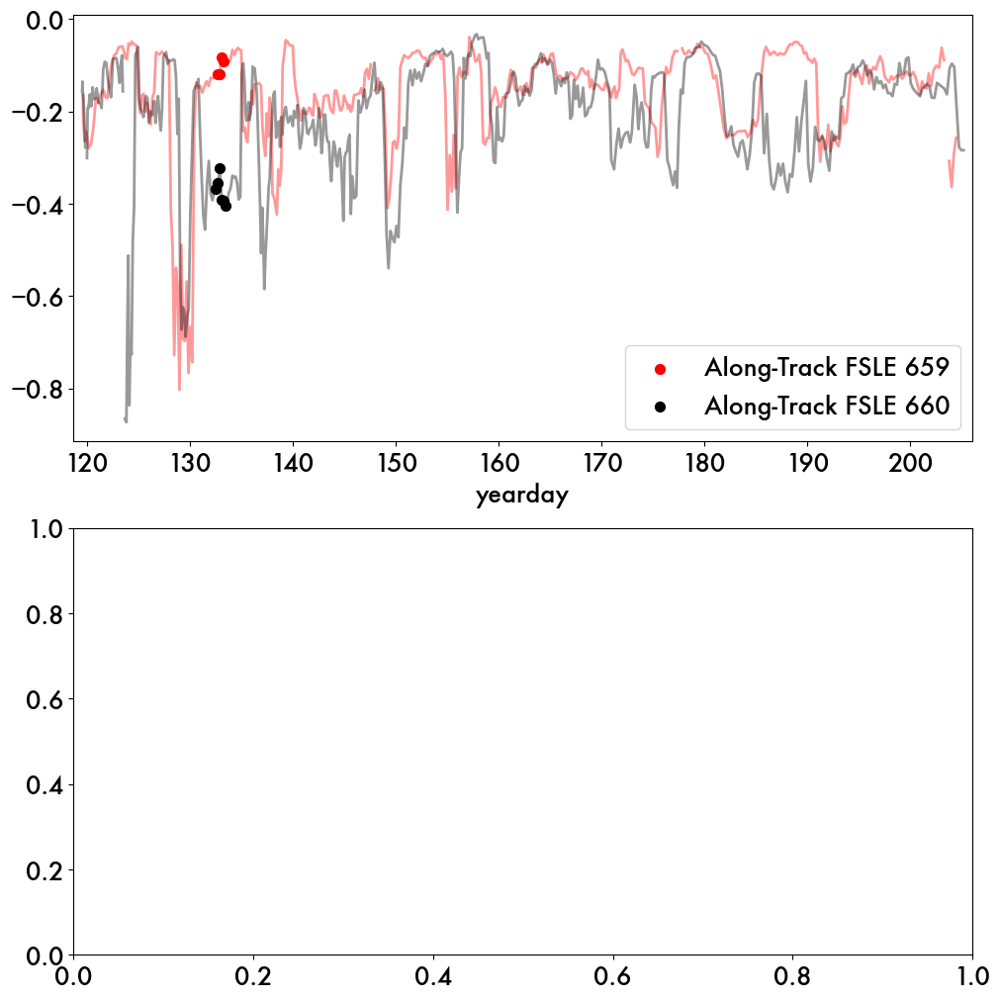

<Figure size 1000x400 with 0 Axes>

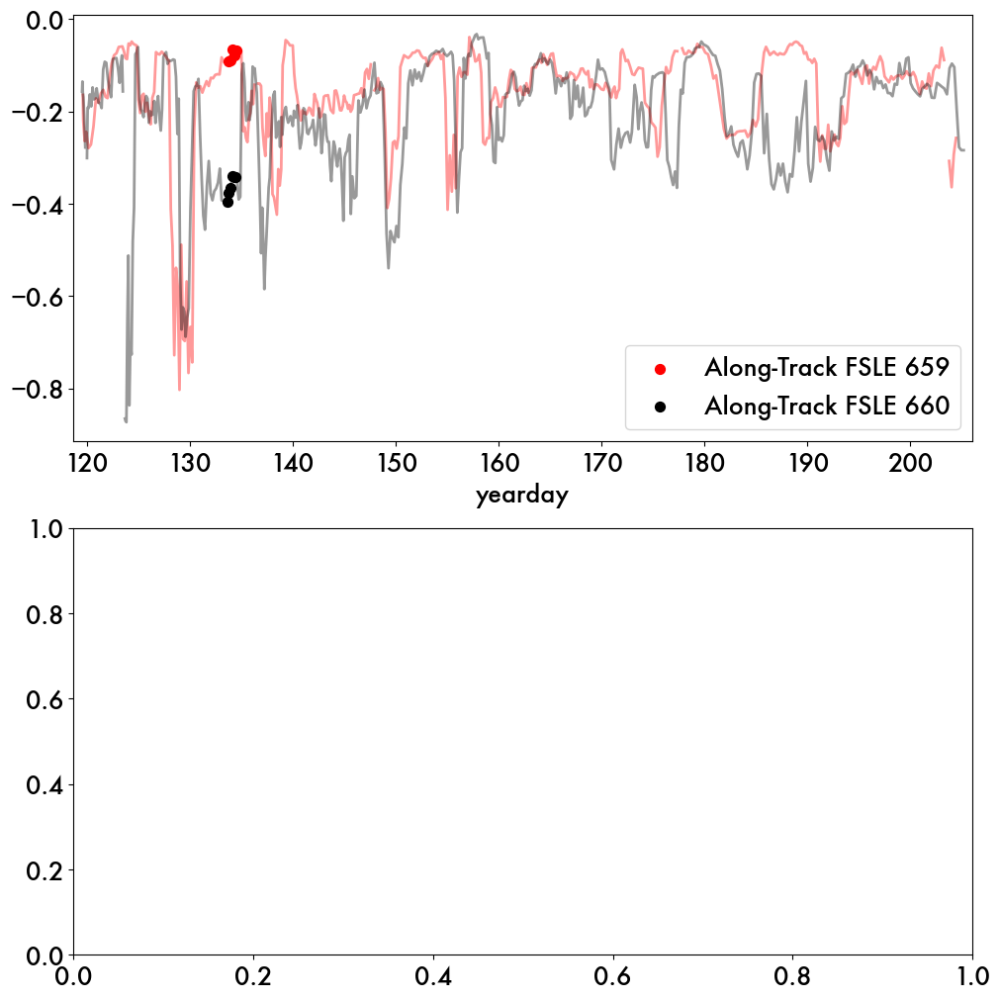

<Figure size 1000x400 with 0 Axes>

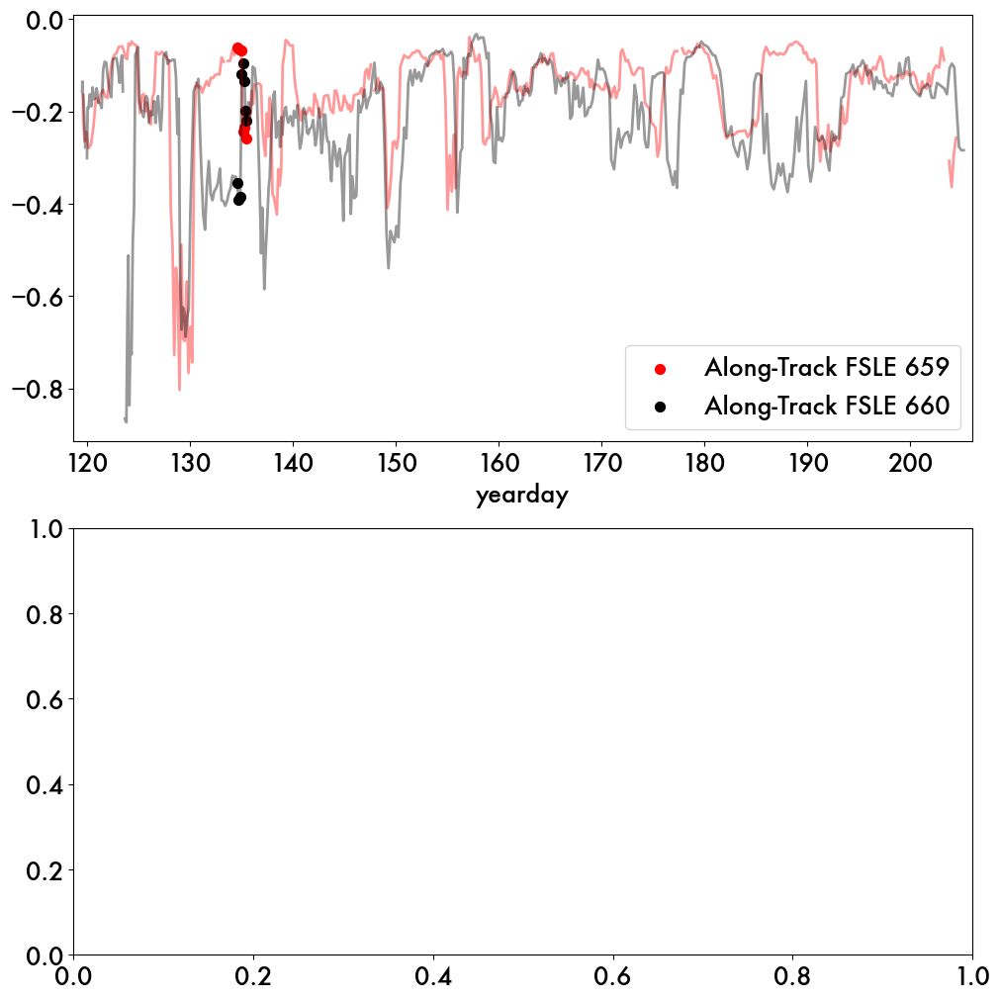

<Figure size 1000x400 with 0 Axes>

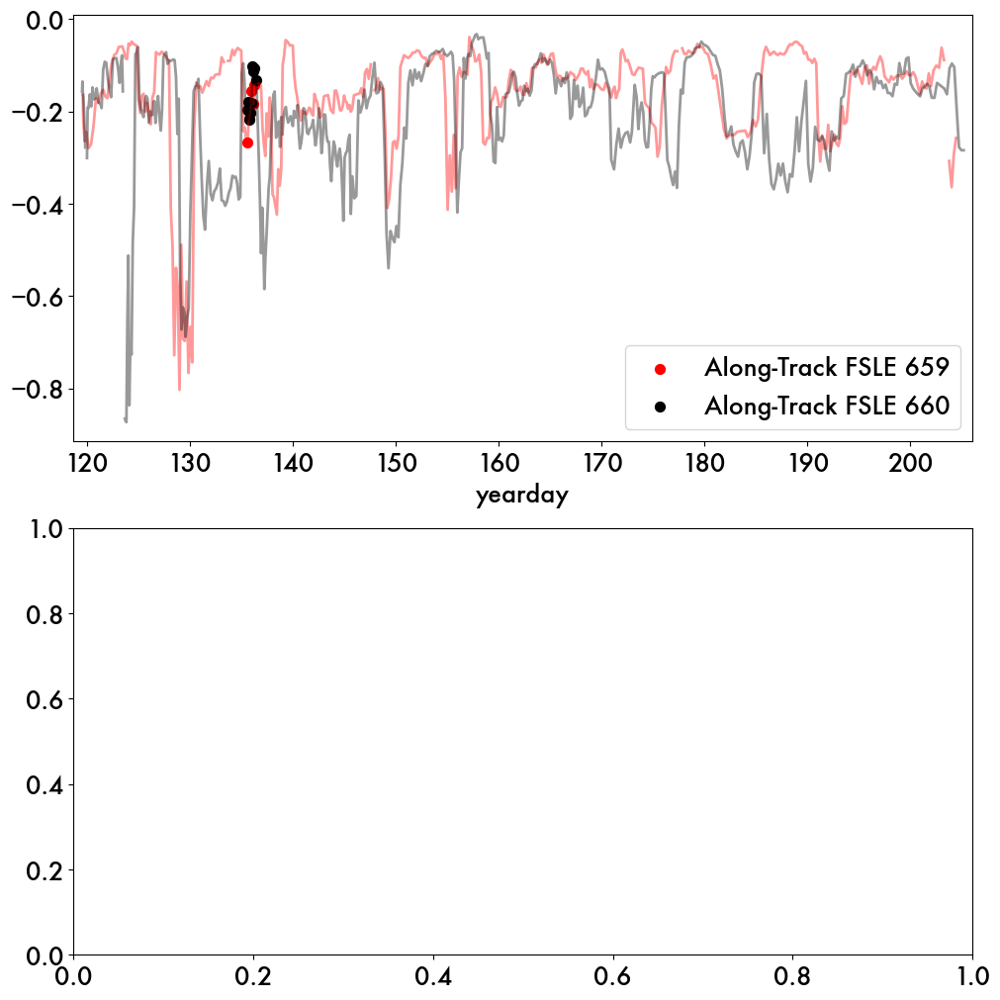

<Figure size 1000x400 with 0 Axes>

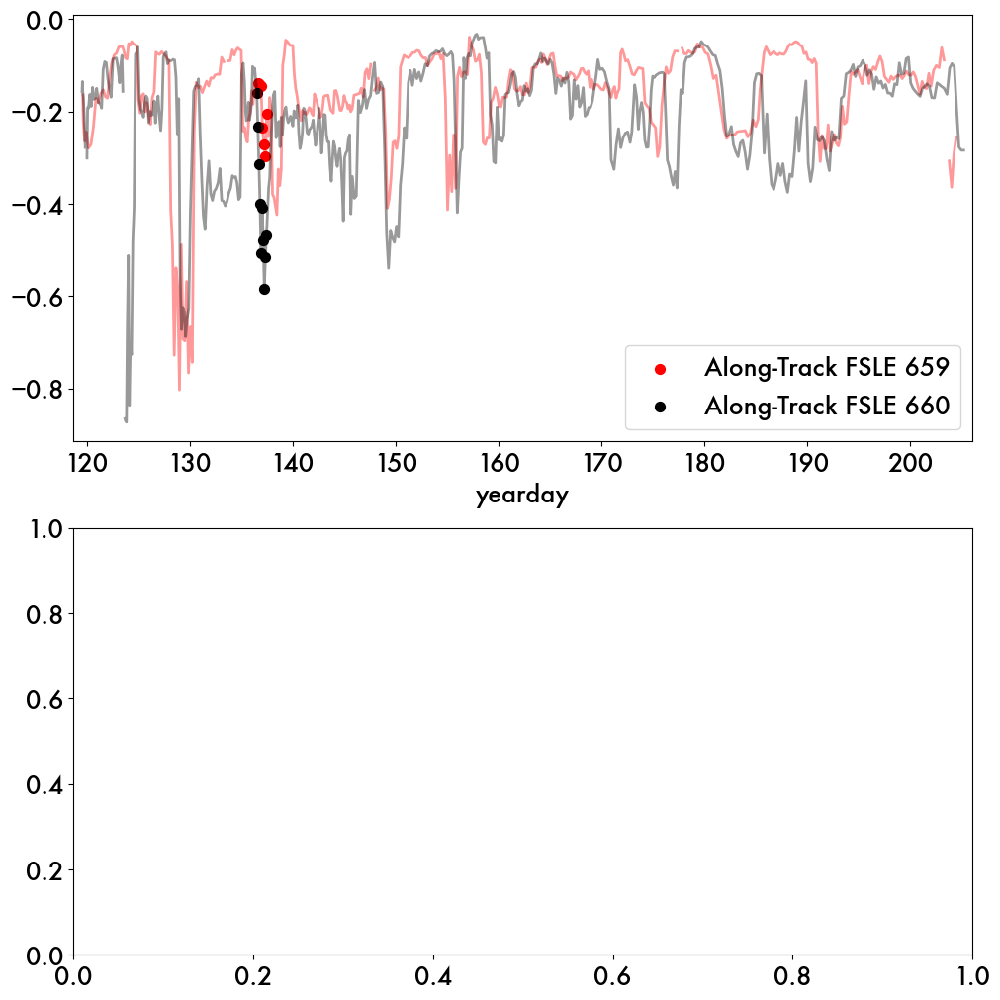

<Figure size 1000x400 with 0 Axes>

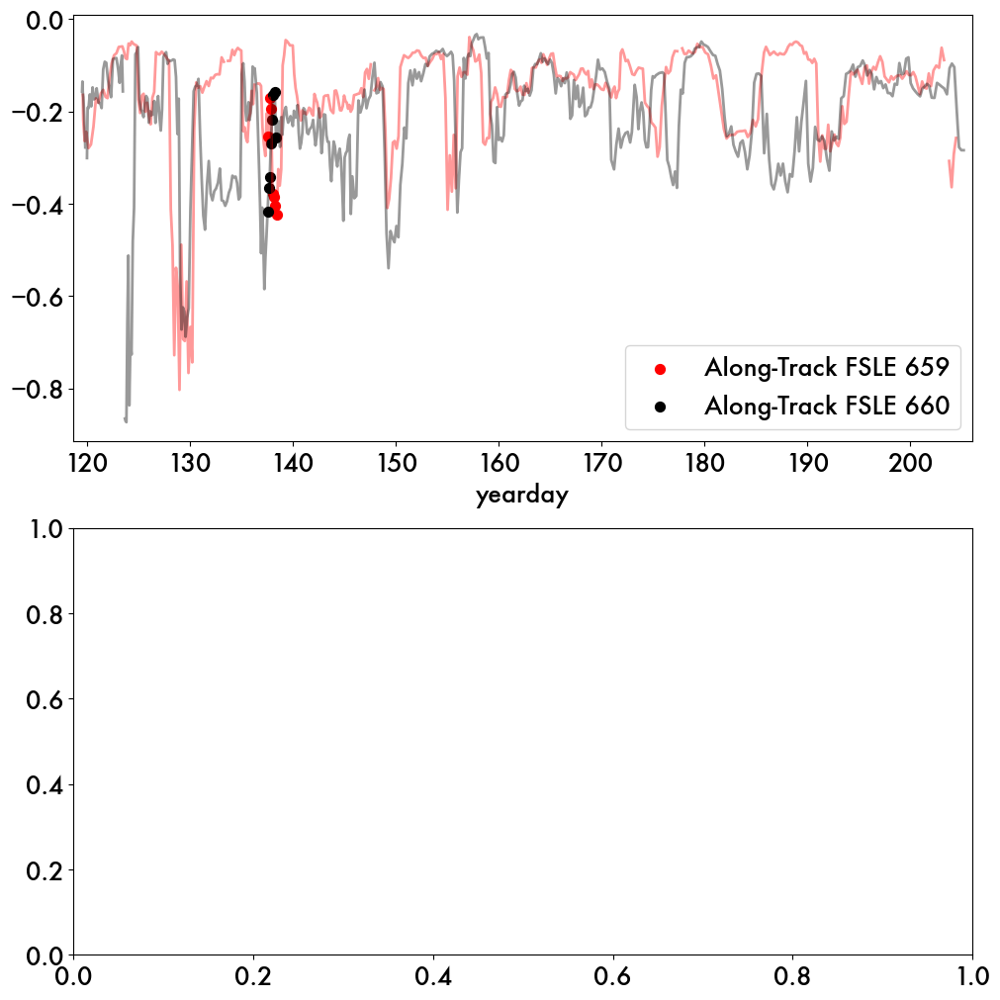

<Figure size 1000x400 with 0 Axes>

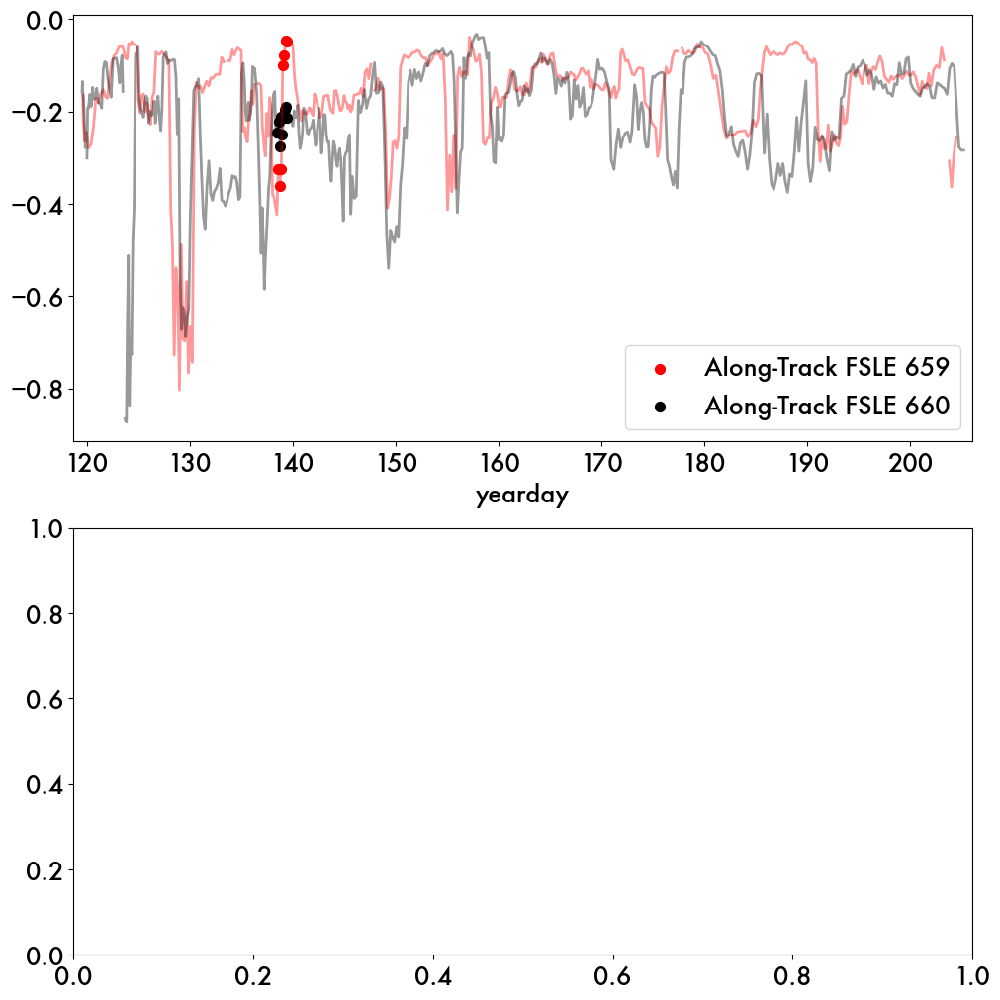

In [215]:
# Combining subplots

# make gif of fsle
size = 18
params = {'legend.fontsize': size, \
          'xtick.labelsize':size, \
          'ytick.labelsize':size, \
          'font.size':size,
          'font.family':'Futura'}
plt.rcParams.update(params)

adt_sogos = sg.slice_sogos(adt.rename({'latitude':'lat', 'longitude':'lon'}),
                        datestart='2019-04-01', dateend='2019-09-01',
                        lat1=-55, lat2=-48,
                        lon1=31, lon2=38)


file_path = '/Users/sangminsong/OneDrive - UW/Code/SOGOS/scripts/working-figs/animation/'
savefig=False
fname = 'ADT-FSLE_2glider_shortyd'
# Plot along track FSLE values, both along-track and buffered, over time

daylist = np.arange(120,140,1)
for day in daylist:
    fig = plt.figure(figsize=(10,4), constrained_layout=True)
    fig, axs = plt.subplots(2,1, figsize=(10,10), constrained_layout=True)
    ax = axs.flatten()

    
    ax[0].plot(dav_659.days, dav_659.bfsle, linewidth=2, alpha=0.4, c='r')
    ax[0].plot(dav_660.days, dav_660.bfsle, linewidth=2, alpha=0.4, c='k')


    i = np.where(dav_659.days.round()==day)
    ax[0].scatter(dav_659.days[i], dav_659.bfsle[i], 50, color='r', label='Along-Track FSLE 659')
    i = np.where(dav_660.days.round()==day)
    ax[0].scatter(dav_660.days[i], dav_660.bfsle[i], 50, color='k', label='Along-Track FSLE 660')

    # i = np.where(dav_660.days.round()==day)
    # ax.plot(dav_660.days[i], dav_660.bfsle[i],linewidth=5, alpha=0.6, color='k', label='Along-Track FSLE 660')
    # i = np.where(dav_659.days.round()==day)
    # ax.plot(dav_659.days[i], dav_659.bfsle[i], linewidth=5, alpha=0.6, color='r', label='Along-Track FSLE 659')


    ax[0].set_xlabel('yearday')
    ax[0].set_label('')
    ax[0].set_xticks(np.arange(120,210,10))
    ax[0].margins(x=0.01)
    # plt.title('Along-Track FSLE (Strain)')

    ax[0].legend()

    if savefig:
        plt.savefig(file_path + fname + str(day), format='png')
        # print('saved')
        plt.close()



# Oxy plots

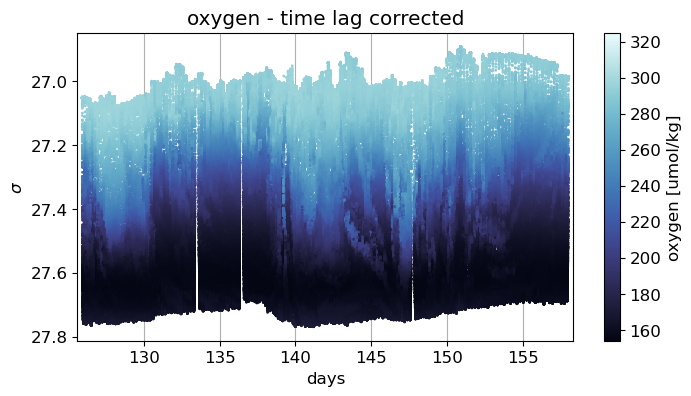

In [15]:
plot_var(gproc.trim(gp_659,126, 158), var='CT')

In [65]:
# to add glider track to where you're plotting a specific variable
day1 = 125
day2 = 160 #125-160, 659
dav = dav_659

fname = 'working-figs/ADTpath_659_yd'
savefig = True
# savefig = False

adt_sogos = sg.slice_sogos(adt.rename({'latitude':'lat', 'longitude':'lon'}),
                        datestart='2019-04-01', dateend='2019-09-01',
                        lat1=-53, lat2=-49,
                        lon1=31.5, lon2=35.5)

daylist = np.arange(day1,day2,1)
for day in daylist:
    plt.figure(figsize=(8, 6))
    adt_sogos.adt.attrs={'long_name':'ADT'}
    dat = adt_sogos.sel(time=sg.ytd2datetime(day))
    map = dat.adt.plot(cmap=cmo.dense, vmin=-1.03, vmax=-.4)

    i = np.where((dav.days>day) & (dav.days<day+1))
    daily_mean_fsle = dav.bfsle[i].mean()
    daily_mean_fsle = np.round(daily_mean_fsle, decimals=2).values

    plt.title('sea surface day ' + str(day) + ', fsle=' + str(daily_mean_fsle))
    plt.plot(dav.lon, dav.lat, linewidth=7, color='w', alpha=0.4)
    plt.scatter(dav.lon[i], dav.lat[i], 60, color='w', label = 'glider path')
    plt.ylabel('')
    plt.xlabel('')
    plt.legend(facecolor='white', labelcolor='white', framealpha=0.3, loc='upper left', borderpad=0.4, handletextpad=0.2)

    if savefig:
        plt.savefig(fname + str(day) + '.png', format='png')
    plt.close();

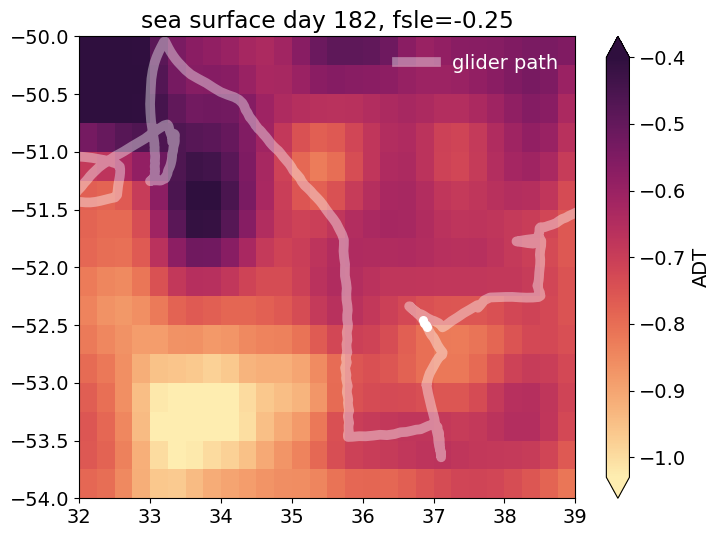

In [ ]:
# %% 5. Zoom into high fsle dates with plotted ADT 
# This is how you do the animated maps 
from sgmod_main import fsle, adt

adt_sogos = slice_sogos(adt.rename({'latitude':'lat', 'longitude':'lon'}),
                        datestart='2019-04-01', dateend='2019-09-01',
                        lat1=-54, lat2=-50,
                        lon1=32, lon2=39)

dav = dav_659
fname = 'ADTpath_659_yd'
savefig = True

# if you want all dates above a threshold
# cutoff = -.4
# ind = np.where(dav.fsle<cutoff)
# days = pd.unique(dav.days[ind].round())

# if you want to select the dates; eddy:[187,194)
# days = np.arange(182,199,1)  # add 3 days either side

params = {'legend.fontsize': 14, \
          'xtick.labelsize':14, \
          'ytick.labelsize':14, \
          'font.size':14}
plt.rcParams.update(params)


daylist = np.arange(182,183,1)
for day in daylist:
    plt.figure(figsize=(8, 6))
    
    adt_sogos.adt.attrs={'long_name':'ADT'}
    dat = adt_sogos.sel(time=sg.ytd2datetime(day))
    map = dat.adt.plot(cmap=cmo.matter, vmin=-1.03, vmax=-.4)

    # ind = np.where(dav.days.round()==day)
    # print(dav.fsle[ind].values)

    i = np.where((dav.days>day) & (dav.days<day+1))
    daily_mean_fsle = dav.bfsle[i].mean()
    # daily_mean_fsle = np.mean(dav.where((dav.days>day) & (dav.days<day+1)).bfsle)
    daily_mean_fsle = np.round(daily_mean_fsle, decimals=2).values


    plt.title('sea surface day ' + str(day) + ', fsle=' + str(daily_mean_fsle))

    # i = np.where(dav.days.round()==day)
    
    plt.plot(dav.lon, dav.lat, linewidth=7, color='w', alpha=0.4, label = 'glider path')
    plt.scatter(dav.lon[i], dav.lat[i], 30, color='w')
    plt.ylabel('')
    plt.xlabel('')
    plt.legend(facecolor='white', labelcolor='white', framealpha=0)

    # plt.tight_layout()
    # if savefig:
    #     plt.savefig(fname + str(day), format='png')

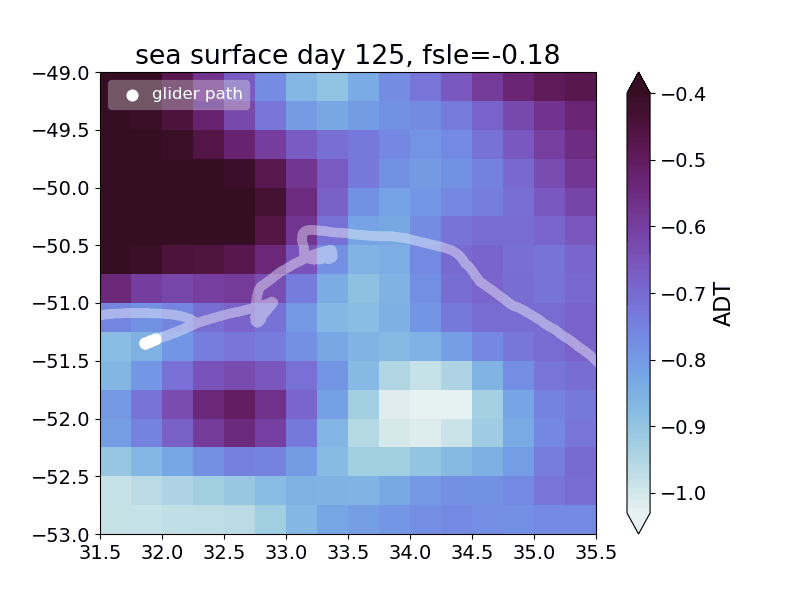

In [66]:
png_dir ='/Users/sangminsong/Library/CloudStorage/OneDrive-UW/Code/SOGOS/scripts/working-figs/animation/'
images = []
for file_name in sorted(os.listdir(png_dir)):
    if file_name.endswith('.png'):
        file_path = os.path.join(png_dir, file_name)
        images.append(iio.imread(file_path))

# Make it pause at the end so that the viewers can ponder
# for _ in range(10):
#     images.append(iio.imread(file_path))

# Save them as frames into a gif 
exportname = png_dir + 'adt_movie.gif'
kargs = { 'duration': .15 }
iio.mimsave(exportname, images, 'GIF', **kargs)

Image(png_dir + 'adt_movie.gif')
# Image(png_dir + 'adt_movie.gif')

In [ ]:
adt_sogos.sel(time=sg.ytd2datetime(day))

<xarray.Dataset>
Dimensions:    (lat: 16, lon: 28)
Coordinates:
    time       datetime64[ns] 2019-07-02
  * lat        (lat) float32 -53.88 -53.62 -53.38 ... -50.62 -50.38 -50.12
  * lon        (lon) float32 32.12 32.38 32.62 32.88 ... 38.12 38.38 38.62 38.88
Data variables:
    adt        (lat, lon) float64 ...
    ugos       (lat, lon) float64 ...
    vgos       (lat, lon) float64 ...
    vgosa      (lat, lon) float64 ...
    err        (lat, lon) float64 ...
    err_vgosa  (lat, lon) float64 ...
    err_ugosa  (lat, lon) float64 ...
    sla        (lat, lon) float64 ...
    ugosa      (lat, lon) float64 ...
Attributes:
    Conventions:                     CF-1.6
    Metadata_Conventions:            Unidata Dataset Discovery v1.0
    cdm_data_type:                   Grid
    comment:                         Sea Surface Height measured by Altimetry...
    contact:                         servicedesk.cmems@mercator-ocean.eu
    creator_email:                   servicedesk.cmems@mercator-ocean.eu
    creator_name:                    CMEMS - Sea Level Thematic Assembly Center
    creator_url:                     http://marine.copernicus.eu
    date_created:                    2021-11-14T23:44:55Z
    date_issued:                     2021-11-14T23:44:55Z
    date_modified:                   2021-11-14T23:44:55Z
    geospatial_lat_max:              -24.875
    geospatial_lat_min:              -74.875
    geospatial_lat_resolution:       0.25
    geospatial_lat_units:            degrees_north
    geospatial_lon_max:              59.875
    geospatial_lon_min:              0.125
    geospatial_lon_resolution:       0.25
    geospatial_lon_units:            degrees_east
    geospatial_vertical_max:         0.0
    geospatial_vertical_min:         0.0
    geospatial_vertical_positive:    down
    geospatial_vertical_resolution:  point
    geospatial_vertical_units:       m
    history:                         2021-11-14 23:44:56Z: Creation
    institution:                     CLS, CNES
    keywords:                        Oceans > Ocean Topography > Sea Surface ...
    keywords_vocabulary:             NetCDF COARDS Climate and Forecast Stand...
    license:                         http://marine.copernicus.eu/web/27-servi...
    platform:                        Altika, Cryosat-2 New Orbit, Haiyang-2B,...
    processing_level:                L4
    product_version:                 vMay2021
    project:                         COPERNICUS MARINE ENVIRONMENT MONITORING...
    references:                      http://marine.copernicus.eu
    software_version:                18.7.3_DUACS_DT2018_baseline
    source:                          Altimetry measurements
    ssalto_duacs_comment:            Jason-3 is the reference mission used fo...
    standard_name_vocabulary:        NetCDF Climate and Forecast (CF) Metadat...
    summary:                         SSALTO/DUACS Near-Real-Time Level-4 sea ...
    time_coverage_duration:          P1D
    time_coverage_end:               2021-11-15T12:00:00Z
    time_coverage_resolution:        P1D
    time_coverage_start:             2021-11-14T12:00:00Z
    title:                           NRT merged all satellites Global Ocean G...
    History:                         Translated to CF-1.0 Conventions by Netc...

# 2D T-S Binned Histograms (Variance/Mean)

In [ ]:
#%% Two plots mean and variance for single variable (with potential density contours)

# mean_array_TSbin = array_TSbin(ts659, nbins, var='pH', stat='mean')
# var_array_TSbin = array_TSbin(ts659, nbins, var='pH', stat='variance')

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(18,8), constrained_layout=True)
axs=axs.flatten()

# Figure out boudaries (mins and maxs)
smin = S659.min()
smax = S659.max()
# tmin = T659.min() - (0.3 * T659.min())
tmin=0
tmax = T659.max() + (0 * T659.min())
# Figure out boudaries (mins and maxs)
 
# Calculate how many gridcells we need in the x and y dimensions
xdim = round((smax-smin)/0.1+1,0).astype(int)
ydim = round((tmax-tmin)+1,0).astype(int)
 
# Create empty grid of zeros
dens = np.zeros((ydim,xdim))
 
# Create temp and salt vectors of appropiate dimensions
ti = np.linspace(1,ydim-1,ydim)+tmin
si = np.linspace(1,xdim-1,xdim)*0.1+smin
# Loop to fill in grid with densities
for j in range(0,int(ydim)):
    for i in range(0, int(xdim)):
        dens[j,i]=gsw.rho(si[i],ti[j],0)
# Substract 1000 to convert to sigma-t
dens = dens - 1000


z0 = axs[0].pcolormesh(S659, T659, mean_array_TSbin, cmap=cmo.matter)
CS = axs[0].contour(si,ti,dens, linestyles='dashed', colors='k')
axs[0].clabel(CS, fontsize=24, fmt='%1.2f')

z1 = axs[1].pcolormesh(S659, T659, var_array_TSbin, cmap=cmo.matter)
CS = axs[1].contour(si,ti,dens, linestyles='dashed', colors='k')
axs[1].clabel(CS, fontsize=24, inline=1, fmt='%1.2f')
plt.colorbar(z0, ax=axs[0])
plt.colorbar(z1, ax=axs[1])

axs[0].set_title('mean pH - 659')
axs[1].set_title('variance pH')


# Label every second level
# axs[0].clabel(CS, fontsize=24, inline=1, fmt='%1.0f')
# axs[1].clabel(CS, fontsize=24, inline=1, fmt='%1.0f') # Label every second level
 

# Dive-averaged Histograms

In [1]:
file_path = '/Users/sangminsong/OneDrive - UW/Code/SOGOS/gridded-vars/'
df_659 = pd.read_csv(file_path + 'df_659_0910.csv', index_col=[0])
df_660 = pd.read_csv(file_path + 'df_660_0910.csv', index_col=[0])

NameError: name 'pd' is not defined

In [389]:
dav_660

<xarray.Dataset>
Dimensions:    (dive: 510)
Coordinates:
  * dive       (dive) int64 0 1 2 3 4 5 6 7 ... 502 503 504 505 506 507 508 509
Data variables:
    u_dive     (dive) float32 ...
    v_dive     (dive) float32 ...
    u_surface  (dive) float32 ...
    v_surface  (dive) float32 ...
    lat        (dive) float32 -51.49 -51.48 -51.46 ... -45.46 -45.43 -45.41
    lon        (dive) float32 30.03 30.05 30.08 30.11 ... 39.01 67.2 67.3 67.4
    days       (dive) float64 nan 119.5 119.6 119.6 ... 205.2 205.4 205.6 205.9
    mld        (dive) float64 ...
    bfsle      (dive) float64 -0.03621 -0.1567 -0.1352 -0.1594 ... nan nan nan
Attributes:
    id:                              sg660_level3
    time_coverage_resolution:        PT1S
    geospatial_vertical_units:       meter
    geospatial_vertical_resolution:  meter
    geospatial_vertical_positive:    no
    platform:                        glider
    geospatial_lat_units:            degrees
    geospatial_lat_resolution:       seconds
    geospatial_lon_units:            degrees
    geospatial_lon_resolution:       seconds
    institution:                     Applied Physics Lab, University of Washi...
    license:                         These data may be redistributed and used...
    keywords_vocabulary:             NASA/GCMD Earth Science Keywords Version...
    references:                      http://data.nodc.noaa.gov/accession/0092291
    Metadata_Conventions:            Unidata Dataset Discovery v1.0
    Conventions:                     CF-1.6
    standard_name_vocabulary:        CF-1.6
    featureType:                     trajectoryProfile
    nodc_template_version:           NODC_NetCDF_Trajectory_Template_v0.9
    naming_authority:                edu.washington.apl
    creator_name:                    Luc Rainville
    creator_url:                     https://iop.apl.washington.edu
    creator_email:                   lucrain@uw.edu
    platform_id:                     SG660
    source:                          Seaglider SG660
    summary:                         SG660 SOGO deployment, April 2019
    project:                         SOGO deployment, April 2019
    glider:                          660
    mission:                         3
    seaglider_software_version:      66.12
    base_station_version:            3.0
    base_station_micro_version:      0
    quality_control_version:         1.12
    processing_level:                1.12
    instrument:                      aa4831 sbe41 wlbb2fl 
    title:                           Physical, chemical, and biological data ...
    keywords:                        Water Temperature, Conductivity, Salinit...
    geospatial_lon_min:              30.02453
    geospatial_lon_max:              68.68470
    geospatial_lat_min:              -53.65789
    geospatial_lat_max:              -45.36117
    time_coverage_start:             2019-04-30T12:13:35Z
    time_coverage_end:               2019-11-25T02:54:28Z
    time_coverage_duration:          P0000-00-208T14:40:52
    geospatial_vertical_min:         0.00
    geospatial_vertical_max:         1000.00
    date_created:                    2021-09-24T17:43:21Z
    date_modified:                   2021-09-24T17:43:21Z
    uuid:                            e93b1778-1d5e-11ec-9f9a-acde48001122

ValueError: autodetected range of [nan, nan] is not finite

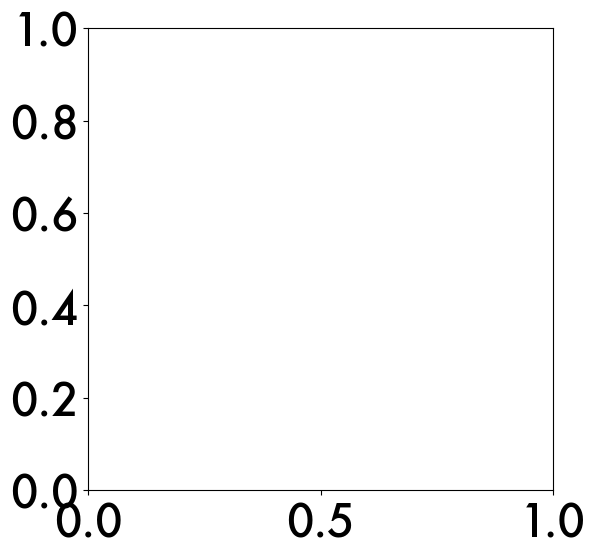

In [390]:

fig = plt.figure(figsize=(6,6))
plt.hist2d(dav_660.mld.values, dav_660.bfsle.values, bins=15)
ax = plt.gca()              
ax.set_ylabel('depth-avg current speed')
ax.set_xlabel('mld')
ax.set_title('660')

Text(0.5, 0, 'fsle')

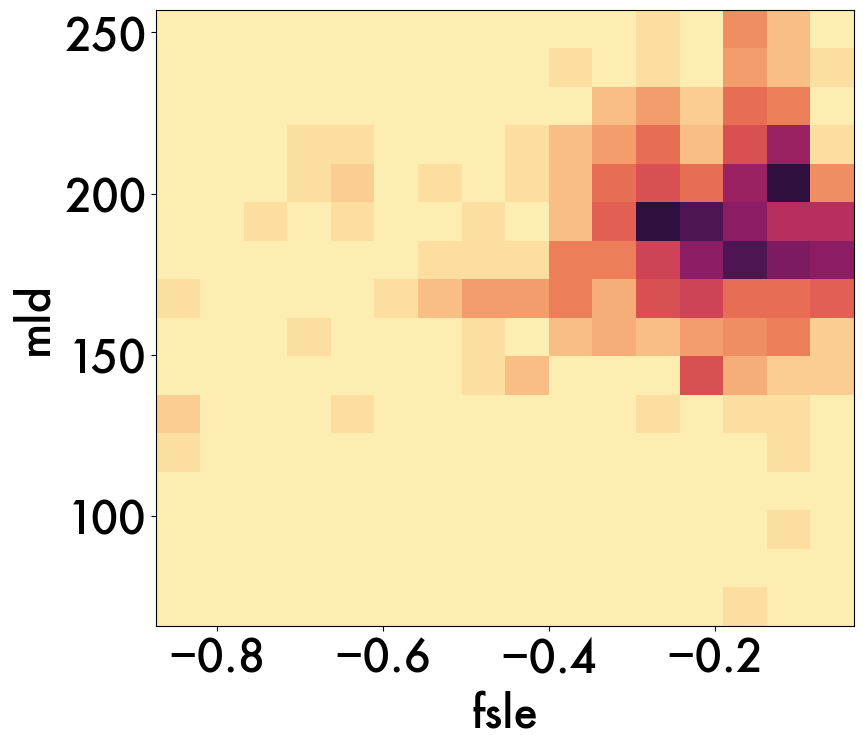

In [416]:
g3 = gp_660
dav = dav_660
mld = dav.mld.values
fsle = dav.bfsle.values

# u_surf = dav.u_surface.values
# v_surf = dav.v_surface.values
u_dive = dav.u_dive.values
v_dive = dav.v_dive.values

# speed = np.sqrt(u_surf**2 + v_surf**2)
speed = np.sqrt(u_dive**2 + v_dive**2)
df = pd.DataFrame({'speed': speed, 'mld': mld, 'fsle': fsle})
df = df.dropna()

fig = plt.figure(figsize=(9,8))
plt.hist2d(df.fsle, df.mld, bins=16, cmap=cmo.matter)
ax = plt.gca()              
ax.set_ylabel('mld')
ax.set_xlabel('fsle')



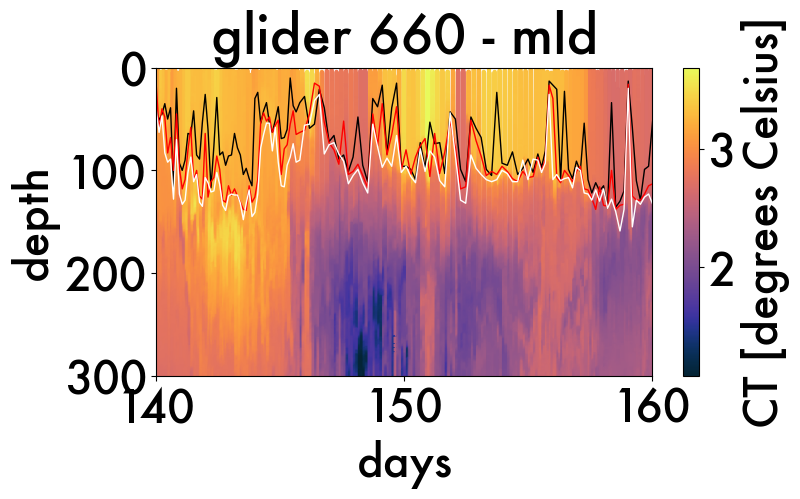

In [388]:
#%% compare mld threshold plot

df = df_660
dav = dav_660

mld01 = dfproc.calc_mld(df, dav, threshold=0.01)
mld02 = dfproc.calc_mld(df, dav, threshold=0.02)
mld03 = dfproc.calc_mld(df, dav, threshold=0.03)


g3 = gp_660
g3 = g3.where((g3.days>140) & (g3.days<160), drop=True)

fig = plt.figure(figsize=(8,4))
ax = fig.gca()

g3.plot.scatter('days','depth', hue='CT', cmap=cmo.thermal, s=4)
ax.invert_yaxis()
ax.margins(x=0.01)
ax.set_ylabel('depth')
ax.set_title('glider 660 - mld')
ax.set_ylim([300,0])
ax.set_xlim([140,160])

ax.plot(dav.days, mld01, color='black', linewidth=1)
ax.plot(dav.days, mld02, color='red', linewidth=1)
ax.plot(dav.days, mld03, color='white', linewidth=1)